In [1]:
from legend_plot_style import LEGENDPlotStyle as lps

In [2]:
lps.use('legend_talks')

In [3]:
import os
import pandas as pd
import numpy  as np

import matplotlib.pyplot as plt
import matplotlib.dates  as mdates

from datetime   import datetime, timezone
from legendmeta import LegendMetadata

lmeta = LegendMetadata('/Users/romoluque_c/Repositories/legend-metadata/')

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
data_path = '/Users/romoluque_c/LEGEND/TAUP_evt_rate_ana/data_test/skimmed_files'

def read_and_concat_data(group, count, path=data_path):
    dfs = [pd.read_hdf(f'{path}/{group}_r{index:03d}_high_level.hdf')
           for index in range(count)]
    return pd.concat(dfs, verify_integrity=True)

data_p03 = read_and_concat_data('p03', 6)
data_p04 = read_and_concat_data('p04', 4)

## Express timestamps in seconds
data_p03.index = pd.to_datetime(data_p03.index, unit='s')
data_p04.index = pd.to_datetime(data_p04.index, unit='s')

dt    = datetime(2023, 4, 22, 5, 54, 22, tzinfo=timezone.utc)
chmap = lmeta.hardware.configuration.channelmaps.on(dt)

In [6]:
runs_start_lines = []
runs_end_lines   = []
for filename in np.sort([file for file in os.listdir(data_path) if file.endswith(".hdf")]):
    df_filename  = pd.read_hdf(data_path+'/'+filename)
    start_run_t  = pd.to_datetime(df_filename.index[0],  unit='s')
    ending_run_t = pd.to_datetime(df_filename.index[-1], unit='s')
    runs_start_lines.append(start_run_t)
    runs_end_lines  .append(ending_run_t)
    
runs_start_lines = np.array(runs_start_lines)
runs_end_lines   = np.array(runs_end_lines  )

In [7]:
channel_dict = {}
for channel_name, channel_data in chmap.items():
    try:
        channel_dict[channel_data['daq']['rawid']] = (lmeta.channelmap(dt)[channel_name].type, channel_name, lmeta.channelmap(dt)[channel_name].production['mass_in_g'])
    except:
        #print(channel_name)
        continue

In [8]:
## Add detector type, channel name and detector mass to dataframe according to the channel id

channel_df = pd.DataFrame.from_dict(channel_dict, orient='index', columns=['det_type', 'channel_name', 'mass'])
data_p03   = pd.merge(data_p03, channel_df, left_on='channel_id', right_index=True, how='left')
data_p04   = pd.merge(data_p04, channel_df, left_on='channel_id', right_index=True, how='left')

In [9]:
def data_selection(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  & 
                (data.multiplicity     == 1)     &
                (data.is_physical      == True)]

def data_selection_no_mult(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  &
                (data.is_physical      == True)]

def resample_df(df): ## returns the event rates in mHz (evt rate per hour /3600 sec *1000 mHz)
    event_rate_df        = df.resample('H').size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    return event_rate_df_series#[event_rate_df_series>0]

def resample_df_days(df): ## returns the event rates in mHz (evt rate per hour /3600 sec *1000 mHz)
    event_rate_df        = df.resample('D').size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    return event_rate_df_series#[event_rate_df_series>0]

def resample_df_norm_mass(df): ## returns the event rates in mHz normalizing with the mass of each detector
    event_rate_df        = df.resample('H').size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample('H').sum().mass/1000 #transform to kg
    event_rate_norm      = event_rate_df_series/summed_mass
    return event_rate_norm.fillna(0)

def resample_df_norm_mass_days(df): ## returns the event rates in mHz normalizing with the mass of each detector
    event_rate_df        = df.resample('D').size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample('D').sum().mass/1000 #transform to kg
    event_rate_norm      = event_rate_df_series/summed_mass
    return event_rate_norm.fillna(0)

def resample_df_norm_keV_kg(df): ## returns the event rates in mHz*keV/kg
    event_rate_df        = df.resample('H').size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample('H').sum().mass/1000 #transform to kg
    summed_energy        = df.resample('H').sum().energy #keV
    event_rate_norm      = (event_rate_df_series*summed_energy)/summed_mass
    return event_rate_norm.fillna(0)

In [10]:
all_cuts = [('is_pulser',        False),
            ('is_baseline',      False),
            ('is_muon_tagged',   False),
            ('is_valid_channel', True),
            ('multiplicity',     1),
            ('is_physical',      True)]

colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

vert_line_date     = pd.to_datetime('2023-04-14')
vert_line_datetime = pd.to_datetime('2023-04-14 8:00')
vert_line_num      = mdates.date2num(vert_line_datetime)

In [11]:
data_p03_filt = data_selection(data_p03)
data_p04_filt = data_selection(data_p04)

data_p03_no_mult = data_selection_no_mult(data_p03)
data_p04_no_mult = data_selection_no_mult(data_p04)

data_p03_Getrig = data_p03[~(data_p03.channel_id == 999)]
data_p04_Getrig = data_p04[~(data_p04.channel_id == 999)]

### Join p3 and p4
data         = pd.concat([data_p03,         data_p04],         verify_integrity=True)
data_filt    = pd.concat([data_p03_filt,    data_p04_filt],    verify_integrity=True)
data_no_mult = pd.concat([data_p03_no_mult, data_p04_no_mult], verify_integrity=True)
data_Getrig  = pd.concat([data_p03_Getrig,  data_p04_Getrig],  verify_integrity=True)

data_series        = resample_df(data)
data_filt_series   = resample_df(data_filt)
data_Getrig_series = resample_df(data_Getrig)

data_days_series      = resample_df_days(data)
data_days_filt_series = resample_df_days(data_filt)

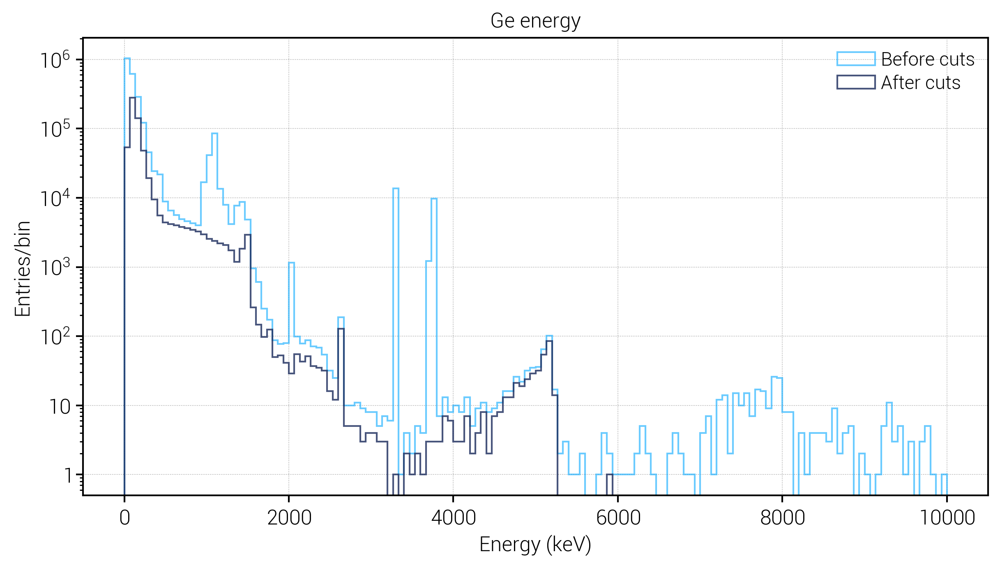

In [12]:
fig, ax = lps.subplots()
data     .energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label='Before cuts', histtype='step', color=lps.colors['legend_blue'])
data_filt.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.8, label='After cuts' , histtype='step', color=lps.colors['legend_darkblue'])
plt.title('Ge energy')
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(loc=1);

In [13]:
legend_colors = np.array(list(lps.colors.keys()))
legend_colors

array(['legend_grey', 'legend_blue', 'legend_darkblue', 'legend_orange',
       'legend_green', 'legend_violet', 'legend_gold', 'legend_darkgreen',
       'legend_purple', 'black', 'red', 'yellow', 'green', 'purple',
       'silver', 'salmon', 'violet', 'darkblue', 'grey', 'gray',
       '1sigma_green', '2sigma_yellow', 'mint', 'forestgreen', 'orange',
       'darkred', 'sand', 'lightgrey', 'lightgray', 'jet', 'teal'],
      dtype='<U16')

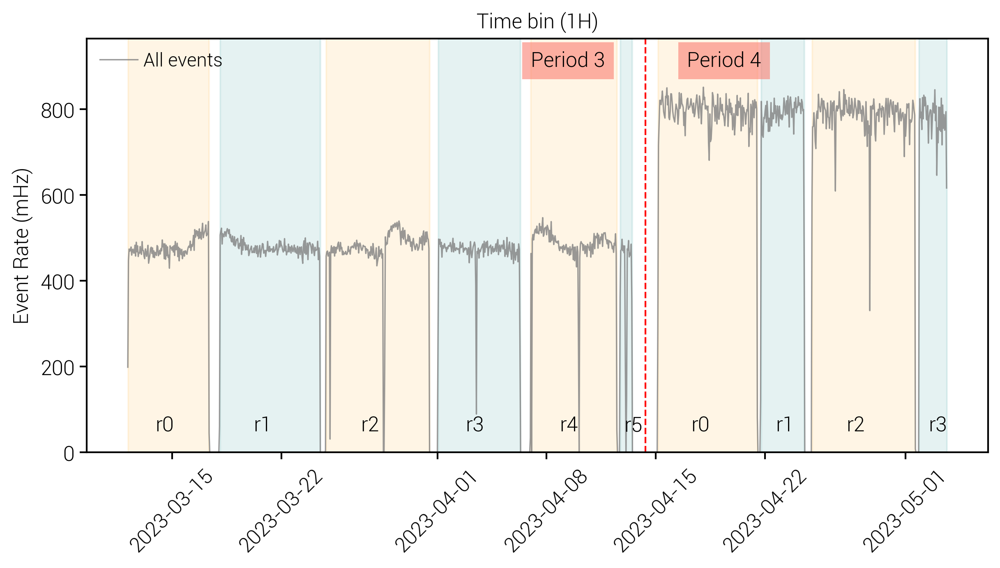

In [14]:
fig, ax = lps.subplots()
plt.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 900, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 900, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for i, (irun, frun) in enumerate(zip(runs_start_lines, runs_end_lines)):
    if (i % 2)==1:
        color='teal'
    else:
        color='orange'
    plt.axvspan(irun, frun, color=color, alpha=0.1)
    if i>5:
        i=i-6
    midpoint = irun + (frun - irun) / 3
    plt.text(midpoint, 50, 'r'+str(i))
    
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(loc='upper left', fontsize=11)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.ylim(0, 965)
plt.show()

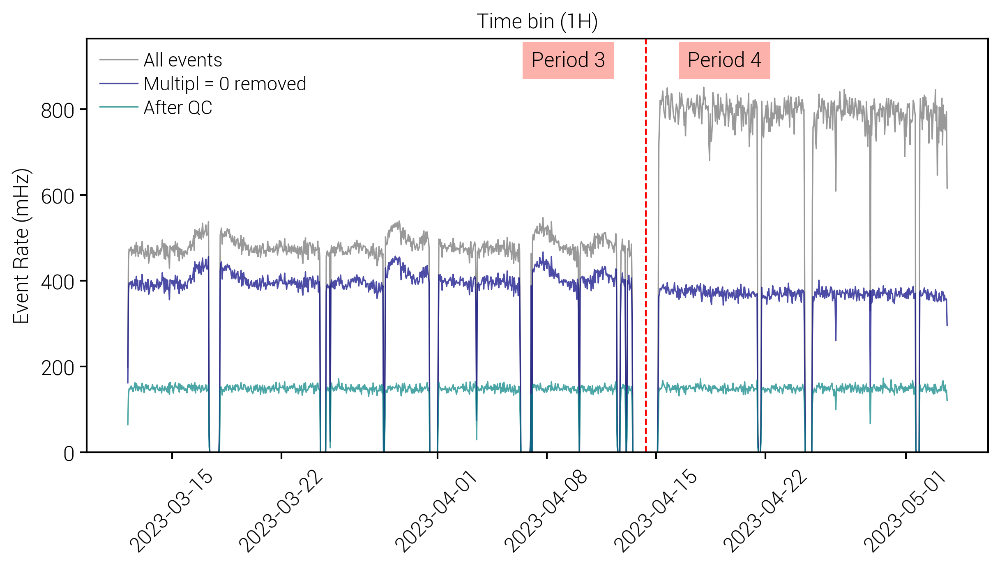

In [15]:
fig, ax = lps.subplots()
plt.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')
plt.plot(data_Getrig_series.index, data_Getrig_series, linewidth=0.8, color='navy', alpha=0.7, label='Multipl = 0 removed')
plt.plot(data_filt_series  .index, data_filt_series,   linewidth=0.8, color='teal', alpha=0.7, label='After QC')

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 900, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 900, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
    
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(loc='upper left', fontsize=11)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.ylim(0, 965)
#plt.yscale('log')
plt.show()

### Multiplicity

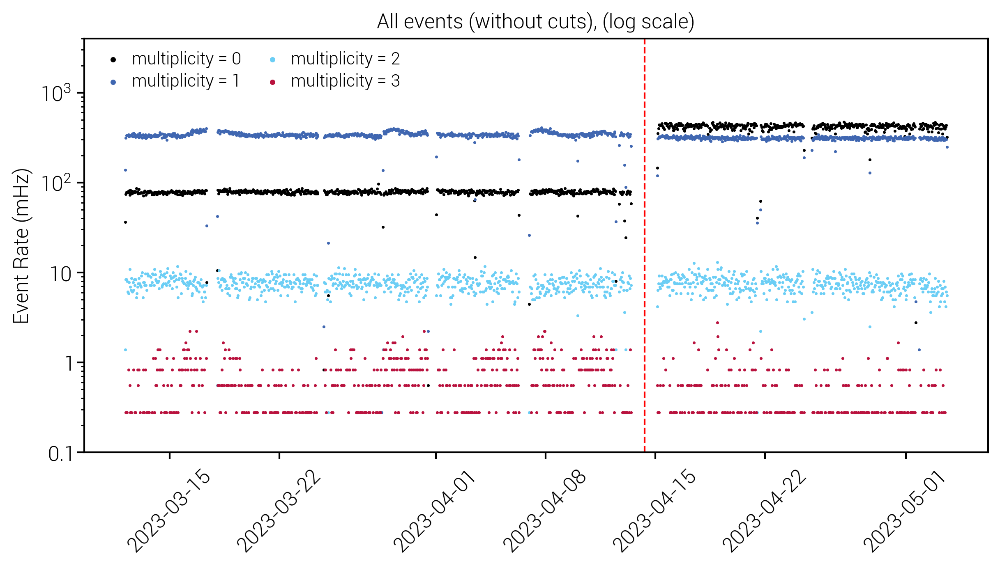

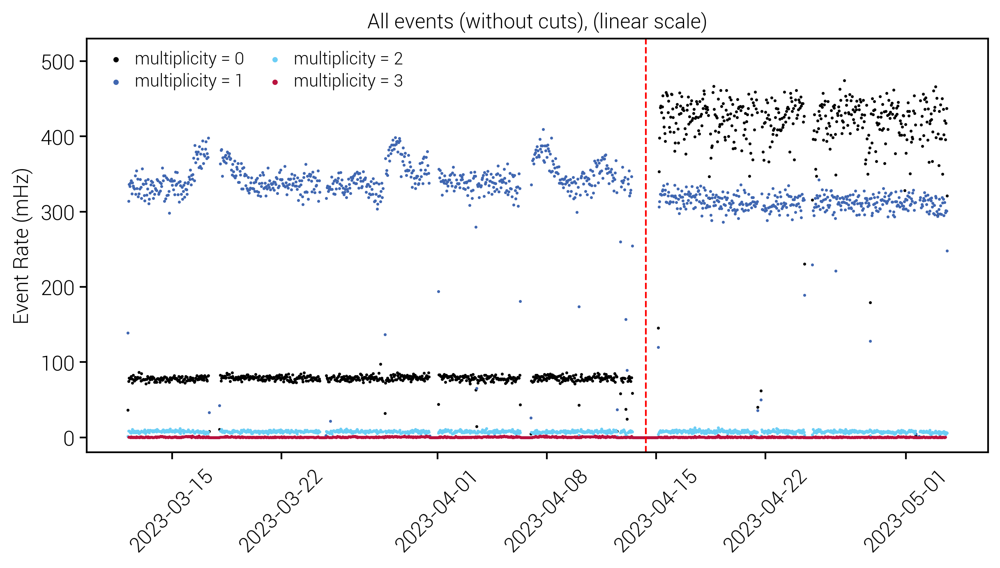

In [16]:
for i, titl in enumerate(['(log scale)', '(linear scale)']):
    fig, ax = lps.subplots()
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    for mult, col in zip(range(4), colors):
        data_m = resample_df(data[data.multiplicity==mult])
        ax.scatter(data_m.index, data_m, s=2, color=col, label=f'multiplicity = {mult}')
        ax.set_title(f'All events (without cuts), {titl}')
        ax.set_ylabel('Event Rate (mHz)')
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
        plt.legend(ncol=2, fontsize=10, loc='upper left', markerscale=3, handletextpad=0.1)

    if i==0:
        ax.set_ylim(10**(-1), 4000)
        ax.set_yscale('log')
    else:
        ax.set_ylim(-20, 530)
    plt.show()

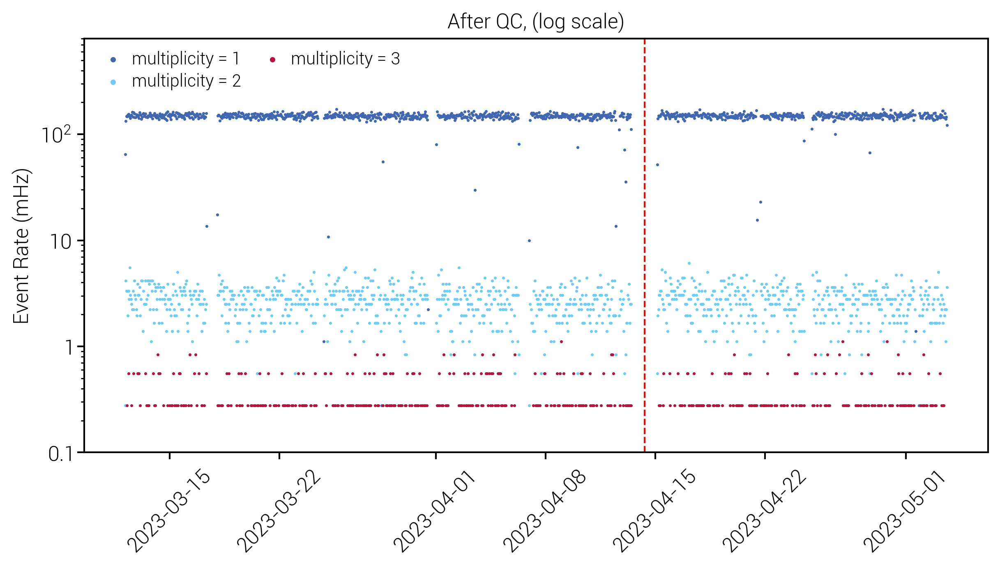

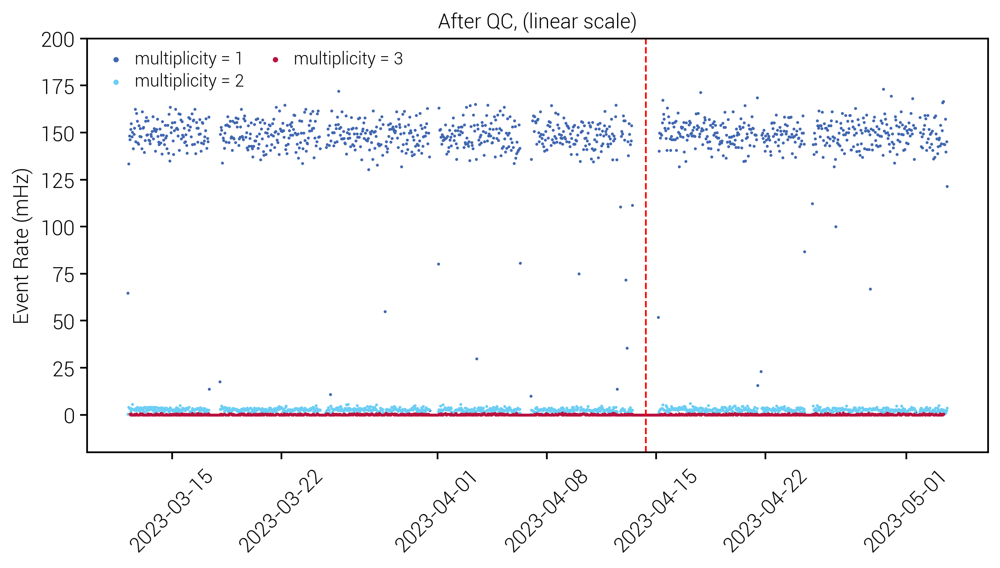

In [17]:
for i, titl in enumerate(['(log scale)', '(linear scale)']):
    fig, ax = lps.subplots()
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    for mult, col in zip(np.arange(1,4), colors[1:]):
        data_m = resample_df(data_no_mult[data_no_mult.multiplicity==mult])
        ax.scatter(data_m.index, data_m, s=2, color=col, label=f'multiplicity = {mult}')
        ax.set_title(f'After QC, {titl}')
        ax.set_ylabel('Event Rate (mHz)')
        plt.legend(ncol=2, fontsize=10, loc='upper left', markerscale=3, handletextpad=0.1)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

    if i==0:
        ax.set_ylim(10**(-1), 800)
        ax.set_yscale('log')
    else:
        ax.set_ylim(-20, 200)
    plt.show()

### Apply cuts individually

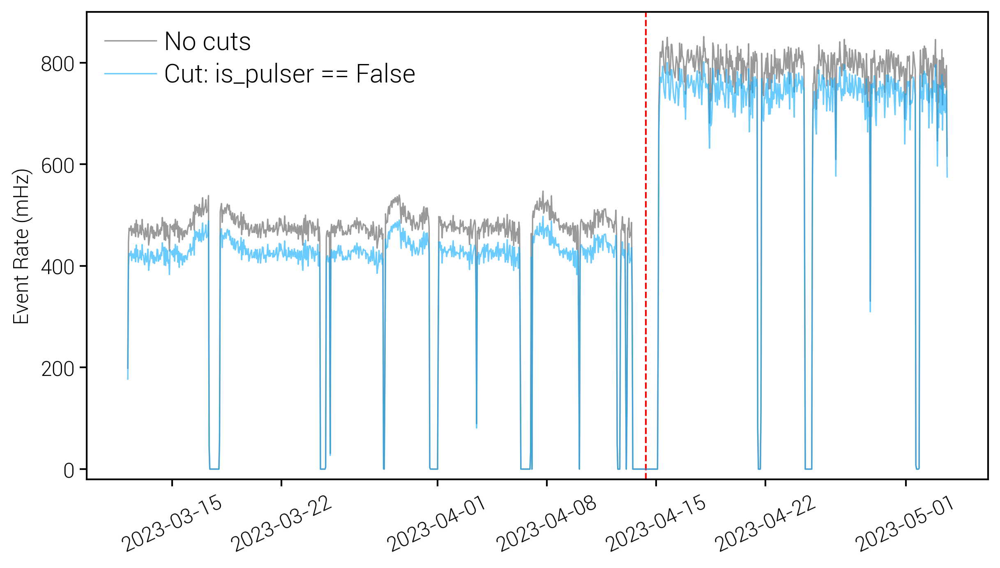

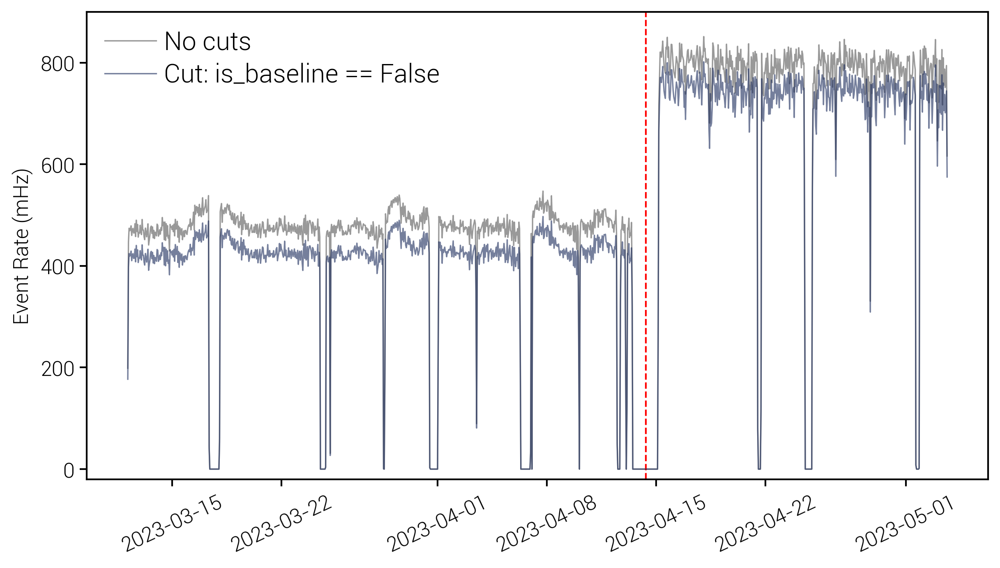

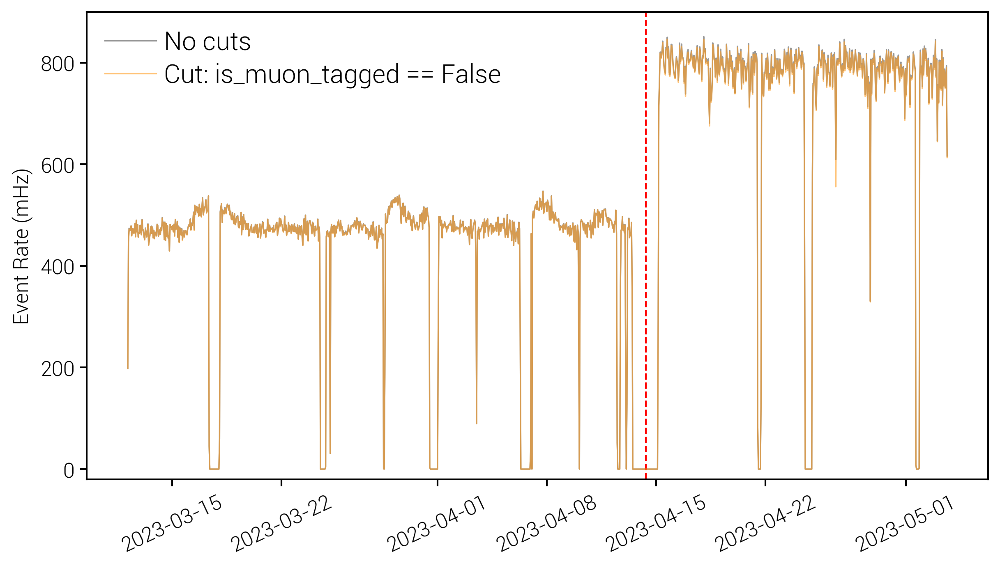

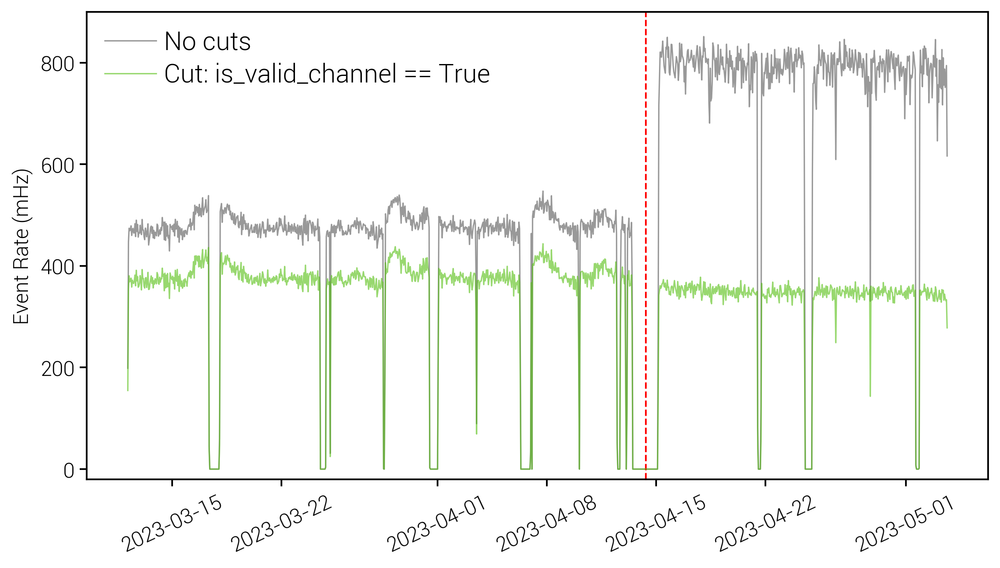

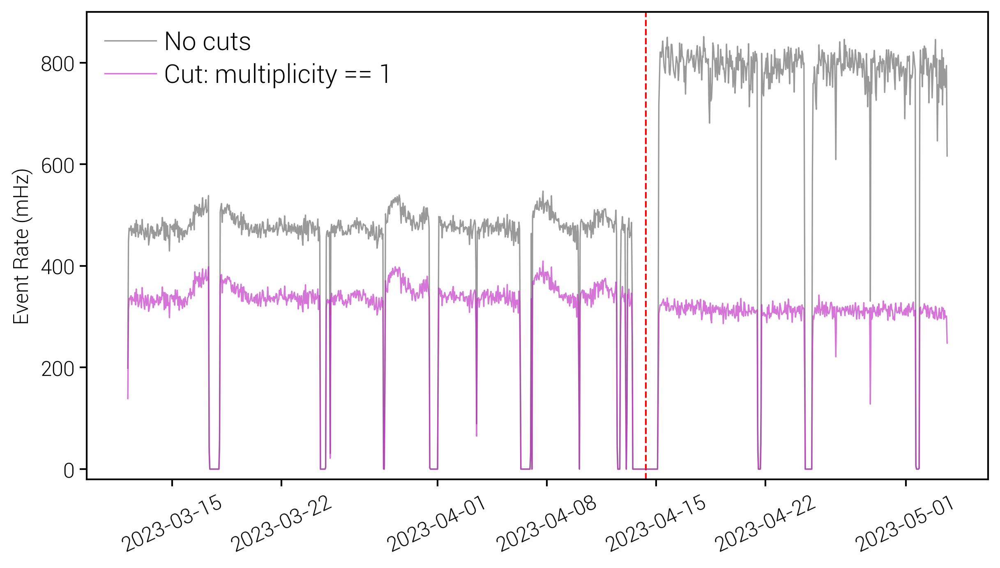

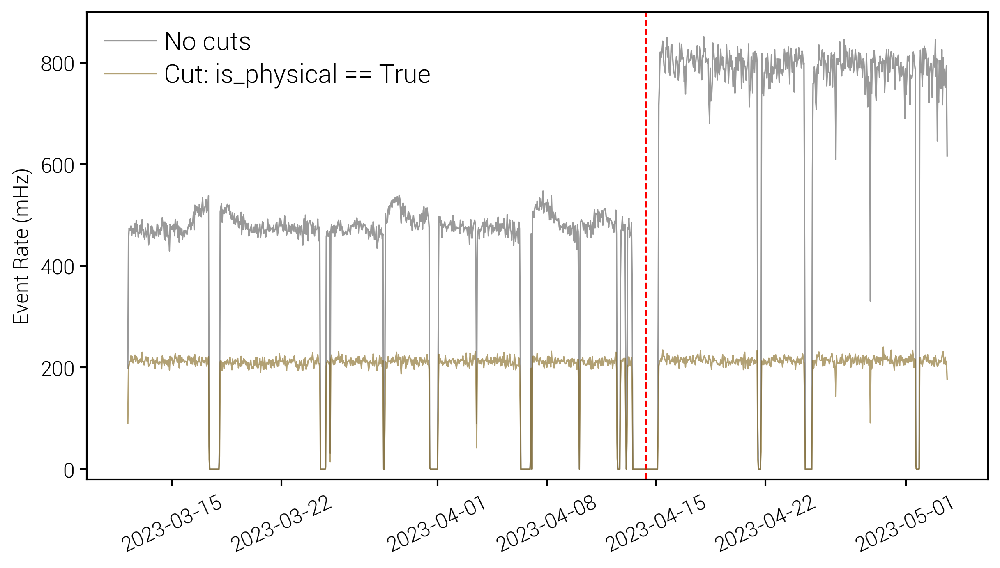

In [18]:
for (cut, val), col in zip(all_cuts, legend_colors[1:]):
    fig, ax = lps.subplots()
    ax.plot(data_series.index, data_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')

    df_test        = data[data[cut]==val]
    df_test_series = resample_df(df_test)

    ax.plot(df_test_series.index,  df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
    ax.set_title(f'')
    ax.set_ylabel('Event Rate (mHz)')
    ax.legend(ncol=1, fontsize=15, loc='upper left')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
    ax.set_ylim(-20, 900)
    plt.show()

### Separate with detector types:

In [19]:
nice_det_labels = ['ICPC', 'Coax',   'BeGe', 'PPC']
det_colors      = ['grey', 'yellow', 'red',  'teal']

det_types  = np.array([val[0] for val in channel_dict.values()])
nice_det_name_dict = {'icpc': nice_det_labels[0],
                      'coax': nice_det_labels[1],
                      'bege': nice_det_labels[2],
                      'ppc' : nice_det_labels[3]}

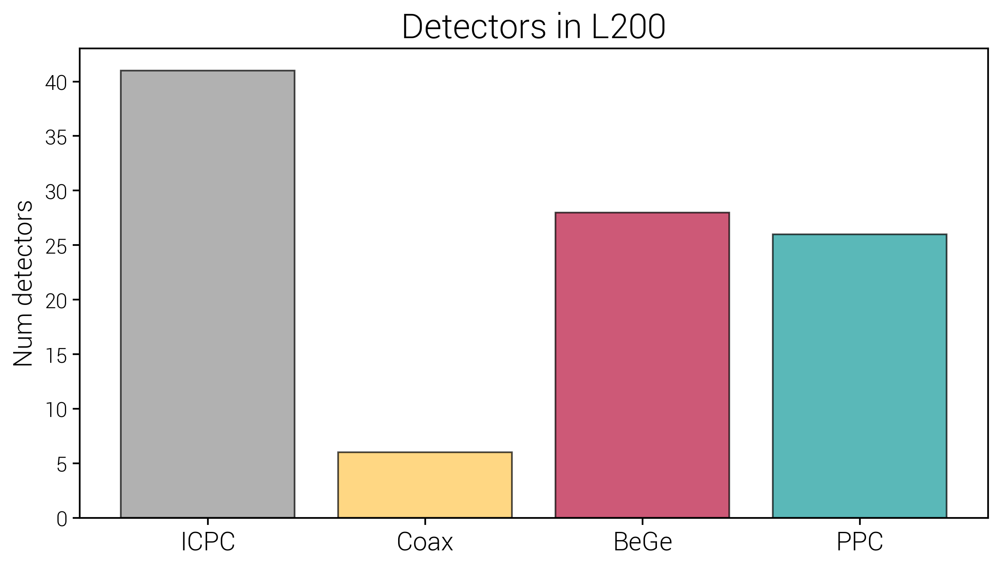

In [20]:
fig, ax = lps.subplots()
for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    d_vals = det_types[det_types==d_type]
    plt.hist(d_vals, bins=np.arange(-0.5, 4.5, 1), align='mid', rwidth=0.8, alpha=0.7, color=lps.colors[col], edgecolor='black')
#xlabels = 
plt.xticks(np.arange(4), nice_det_labels, fontsize=15)  # Centered ticks
plt.title('Detectors in L200', fontsize=20)
plt.ylabel('Num detectors', fontsize=15)
plt.show()

In [21]:
data_filt.det_type.unique()

array(['icpc', 'ppc', 'coax', 'bege'], dtype=object)

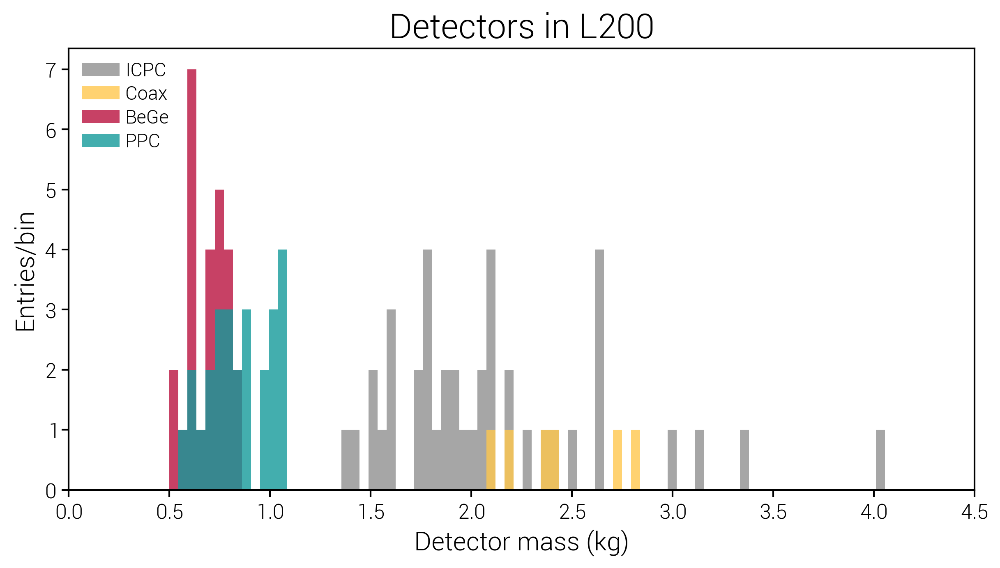

In [22]:
fig, ax = lps.subplots()
for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    d_mass = []
    det_lab = nice_det_name_dict[d_type]
    for val in channel_dict.values():
        if val[0]==d_type:
            d_mass.append(val[2])
    plt.hist(np.array(d_mass)/1000, bins=80, range=(0.5, 4.1), label=f'{det_lab}', alpha=0.8, color=lps.colors[col])
    plt.title('Detectors in L200',   fontsize=20)
    plt.xlabel('Detector mass (kg)', fontsize=15)
    plt.ylabel('Entries/bin',        fontsize=15)
    plt.xlim(0, 4.5)
    plt.legend();

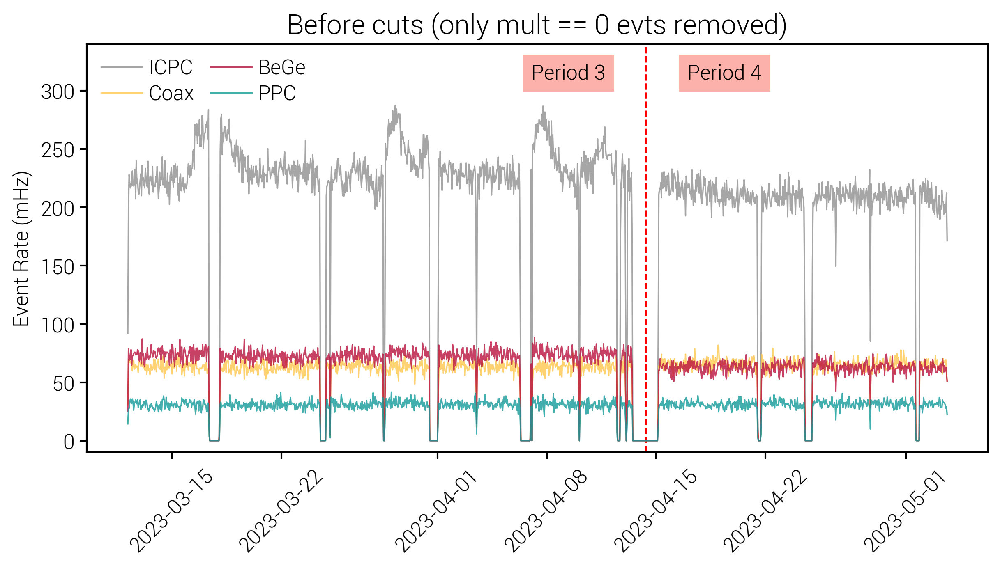

In [23]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 310, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 310, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab         = nice_det_name_dict[d_type]
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)
    plt.plot(data_det_series.index, data_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('Before cuts (only mult == 0 evts removed)', fontsize=16)
plt.ylabel('Event Rate (mHz)')
plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 340)
plt.show()

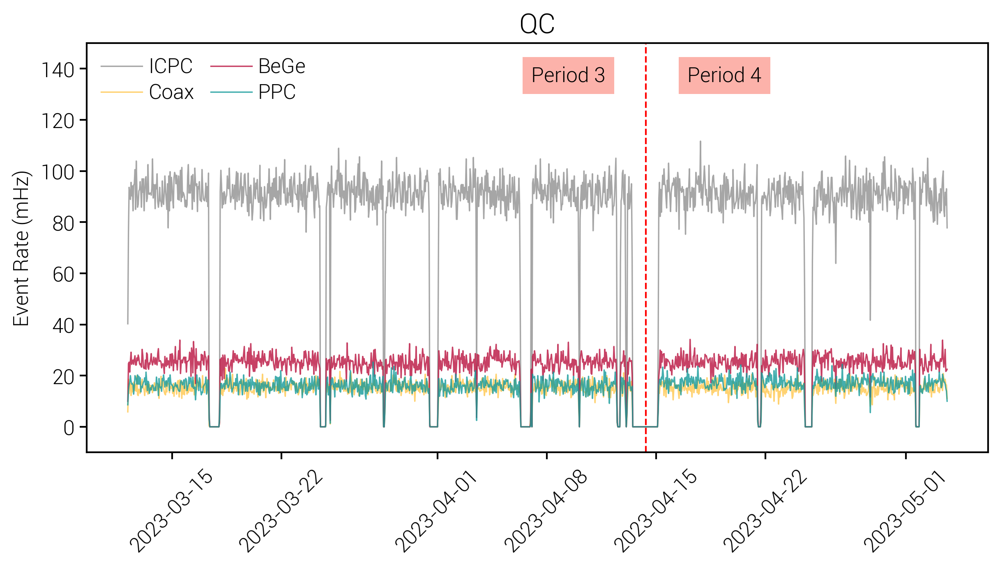

In [24]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 135, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 135, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_series = resample_df(data_filt_det)
    plt.plot(data_filt_det_series.index, data_filt_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('QC', fontsize=16)
plt.ylabel('Event Rate (mHz)')
plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 150)
plt.show()

### Event rate normalized to detector mass

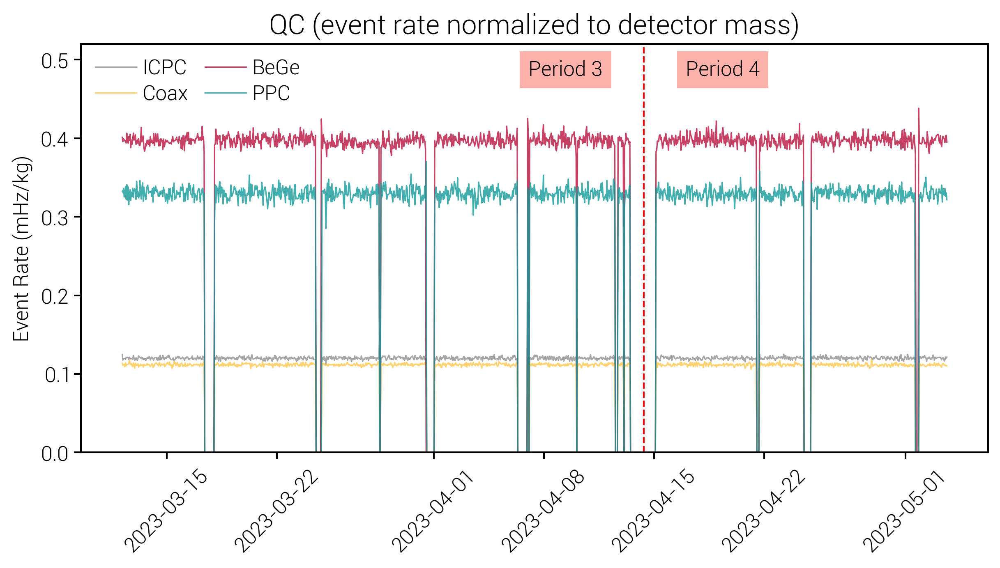

In [25]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 0.48, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 0.48, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_mass_series = resample_df_norm_mass(data_filt_det)
    plt.plot(data_filt_det_mass_series.index, data_filt_det_mass_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('QC (event rate normalized to detector mass)', fontsize=16)
plt.ylabel('Event Rate (mHz/kg)')

plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(0., 0.52)
plt.show()

### Individual cuts to every detector type

--------------------------ICPC----------------------------


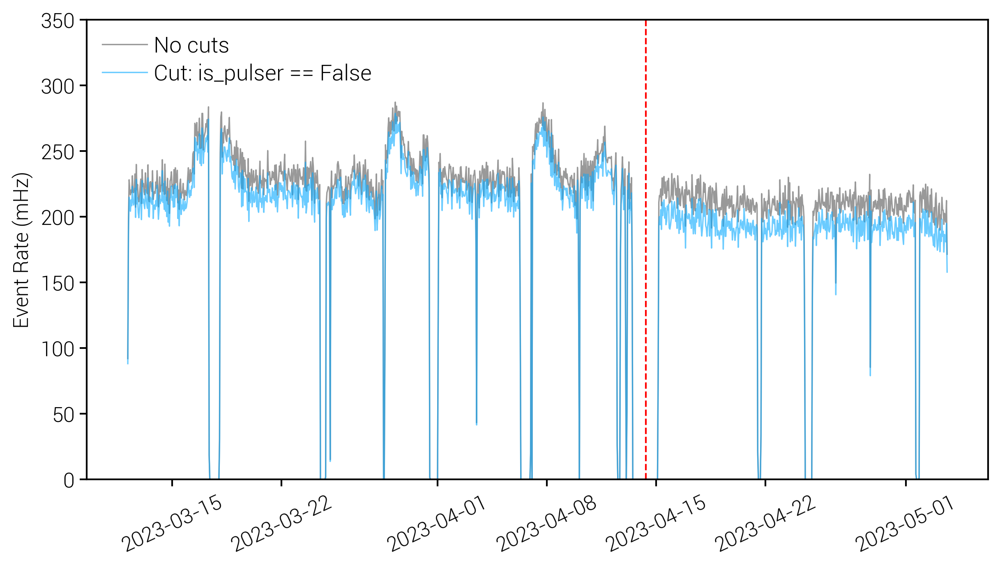

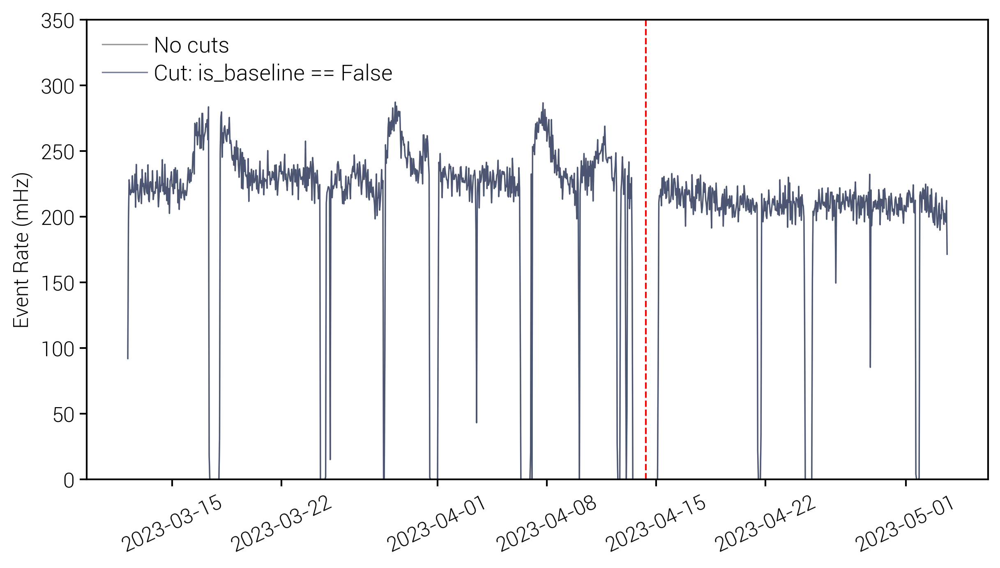

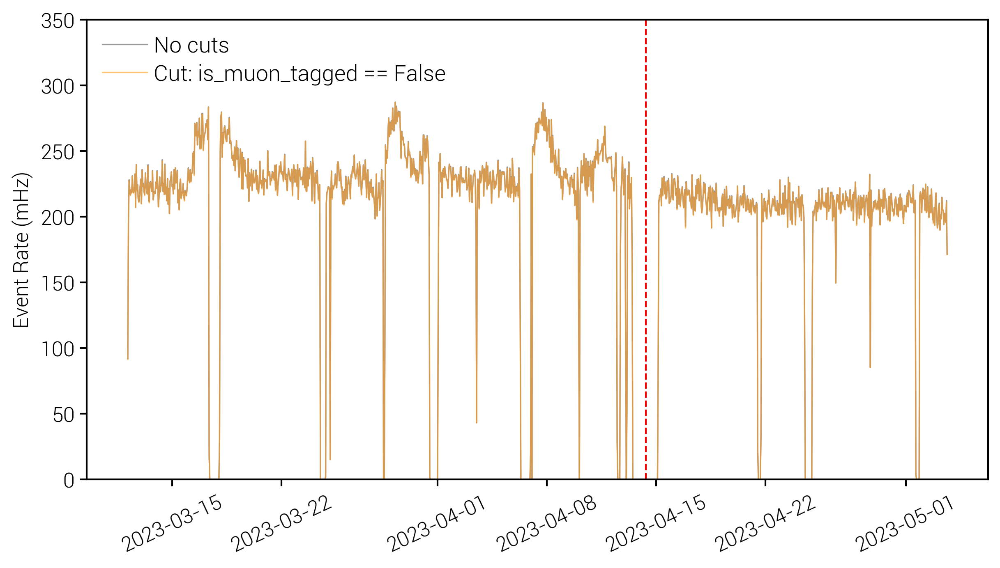

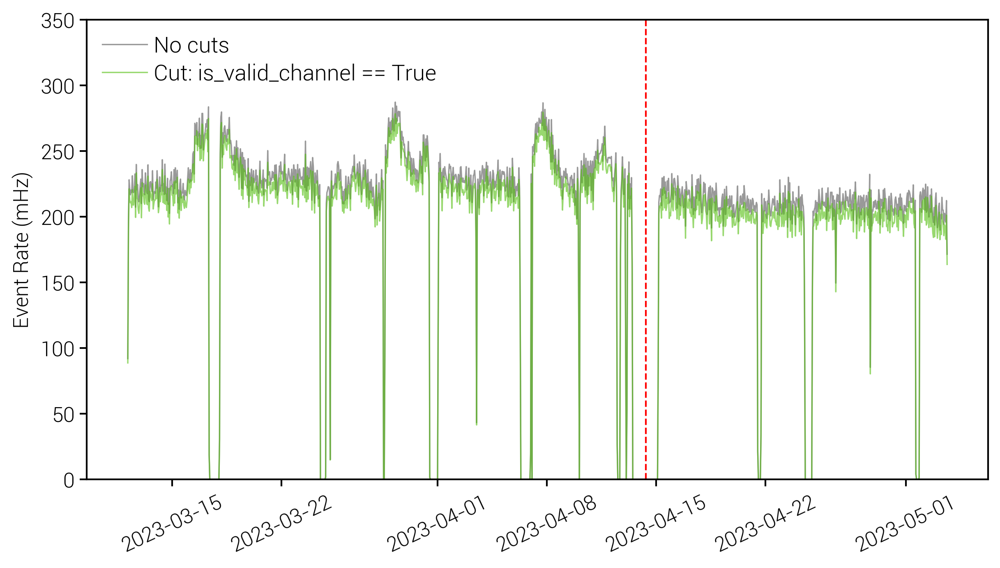

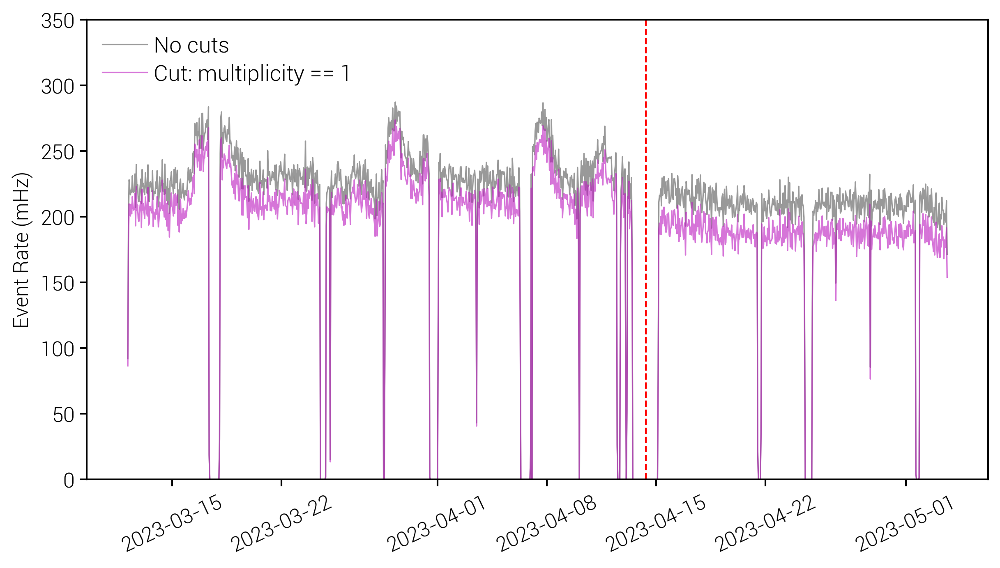

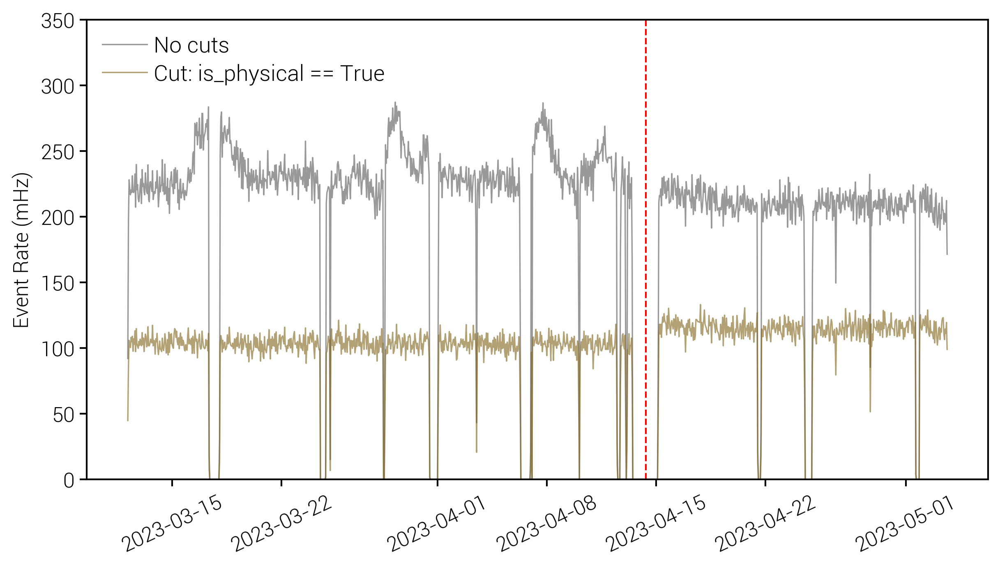

--------------------------Coax----------------------------


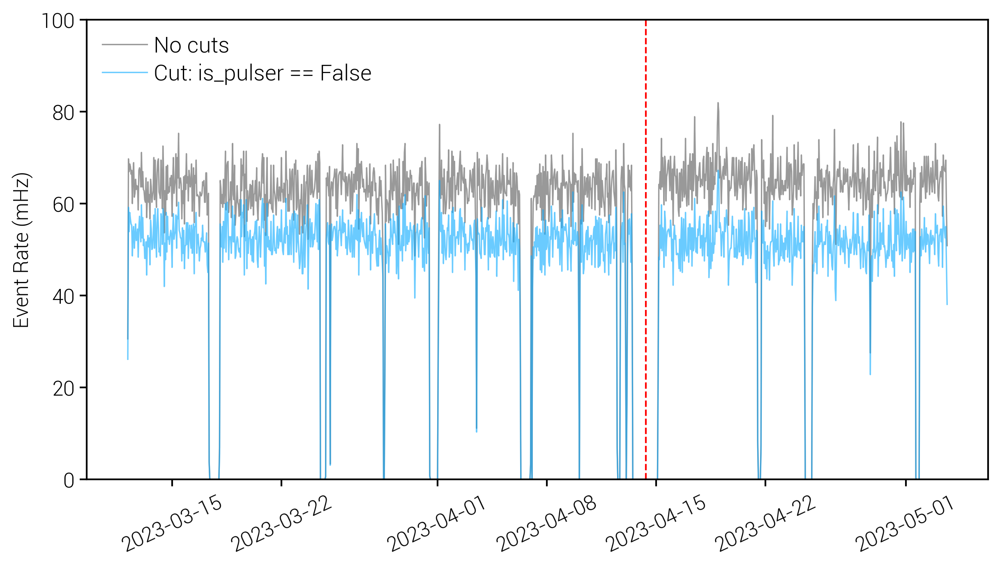

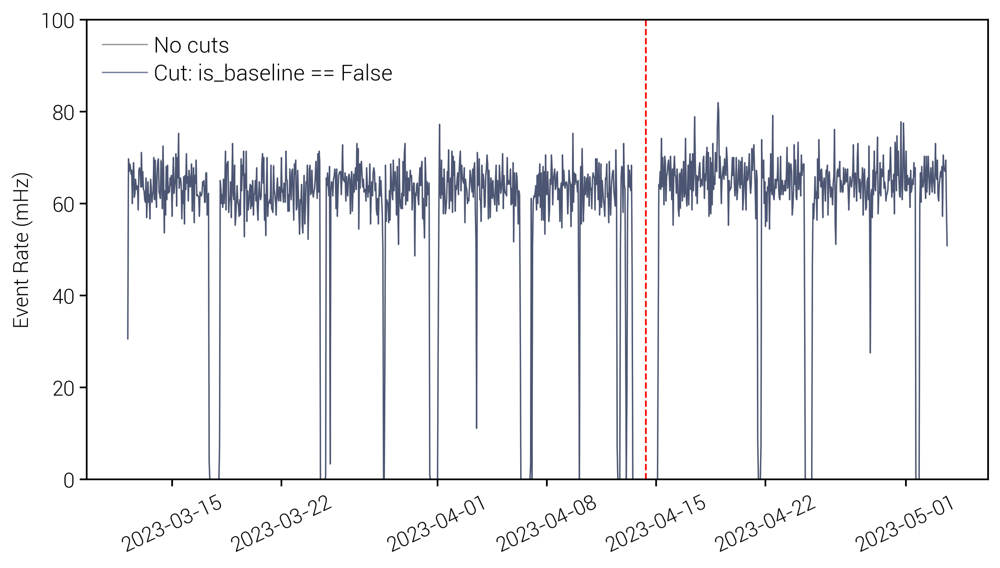

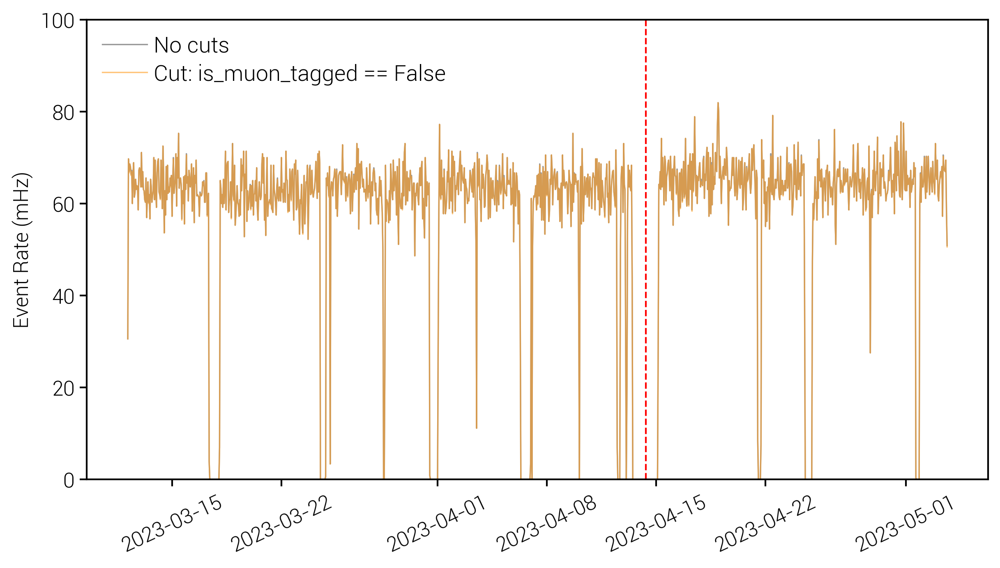

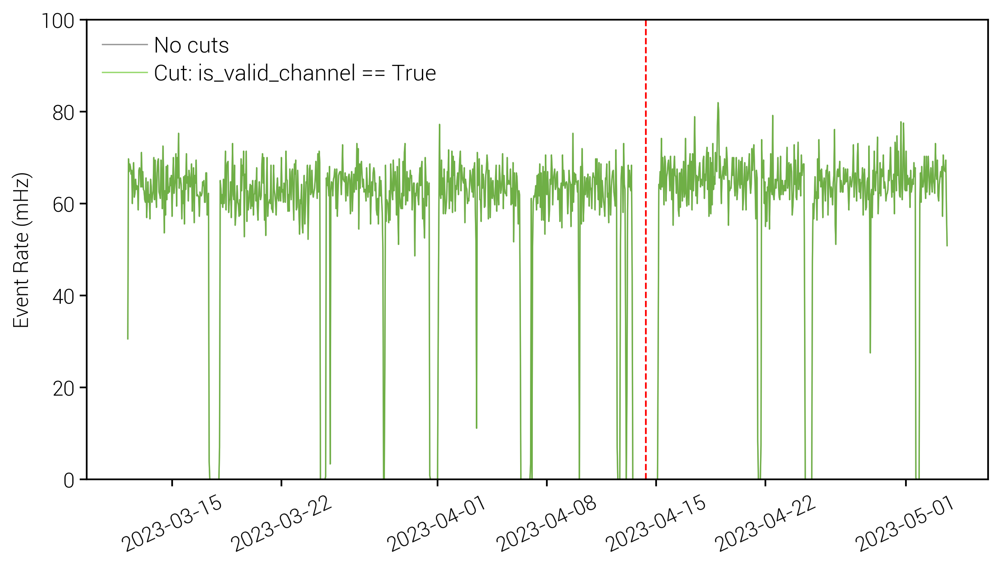

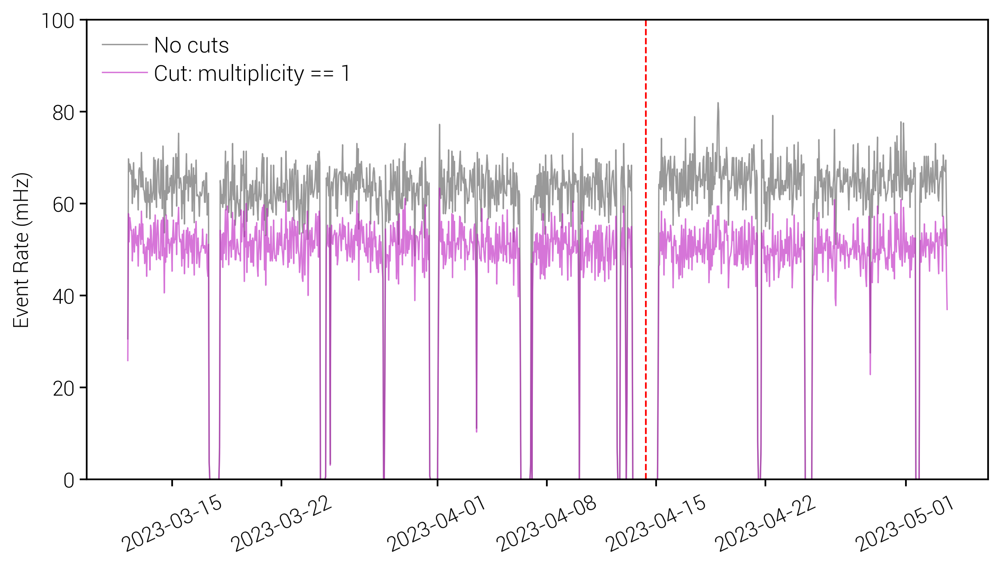

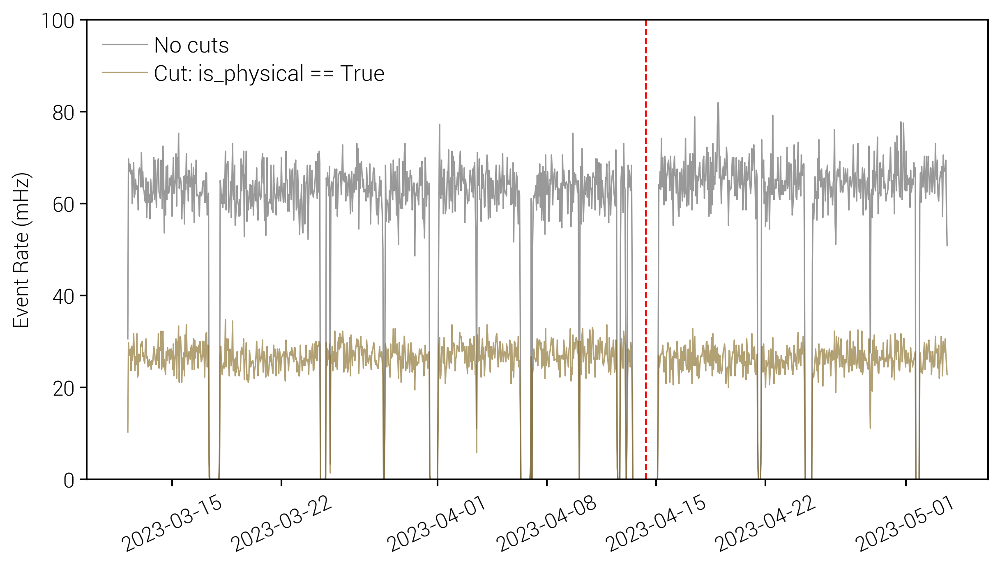

--------------------------BeGe----------------------------


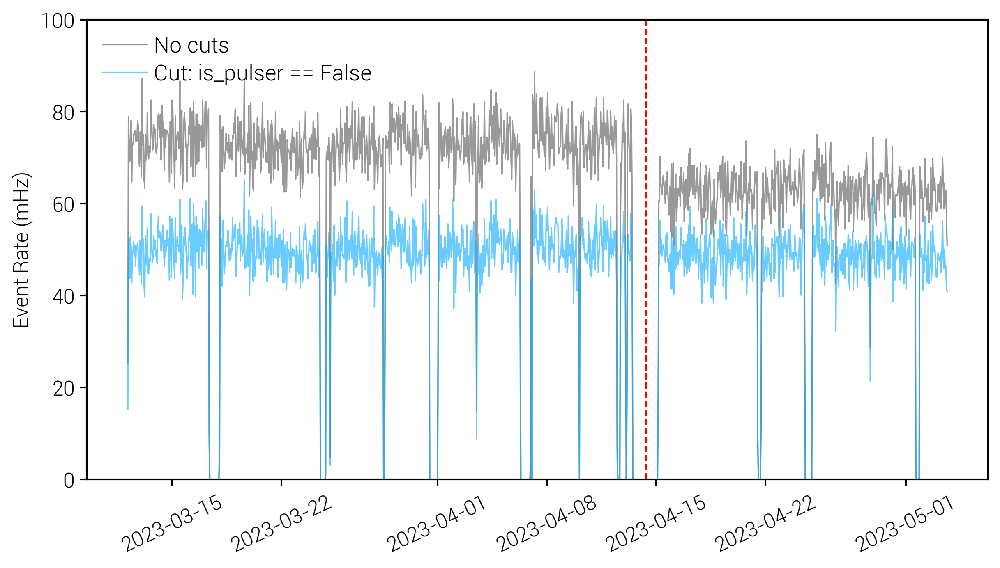

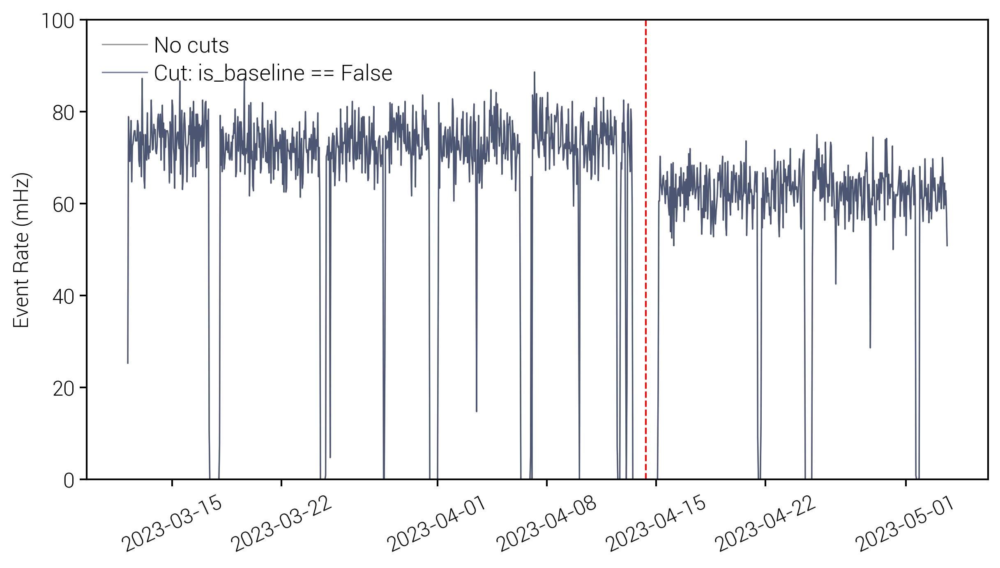

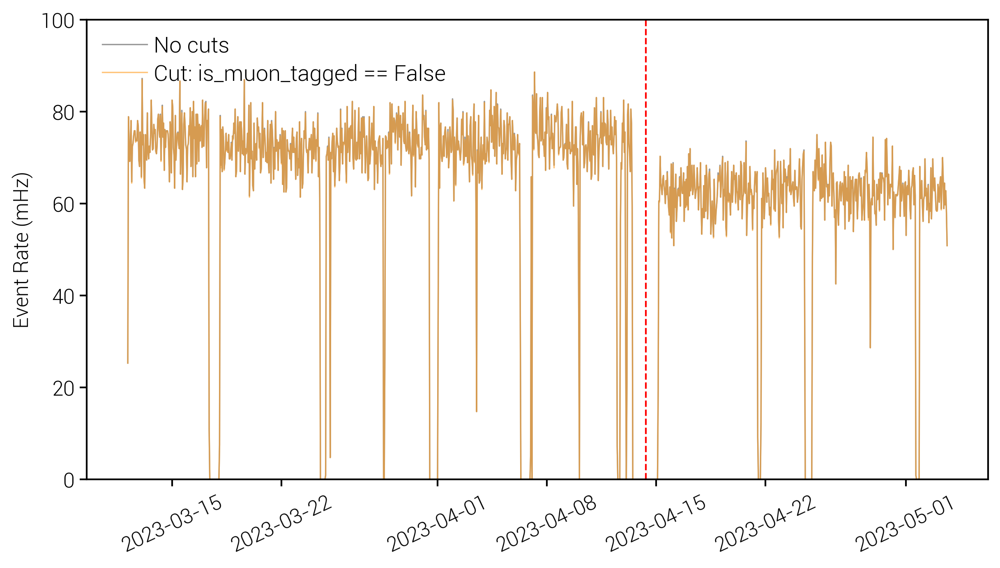

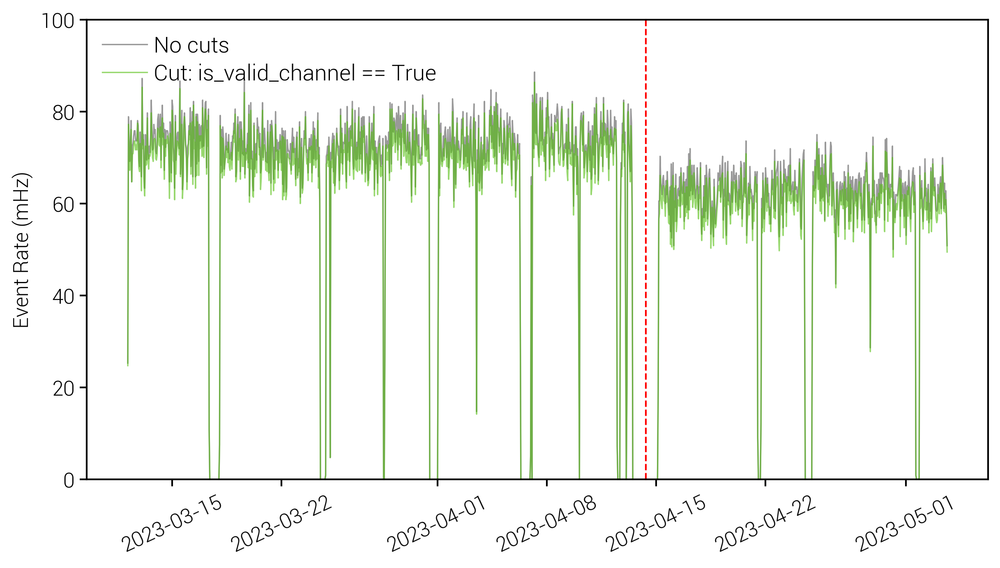

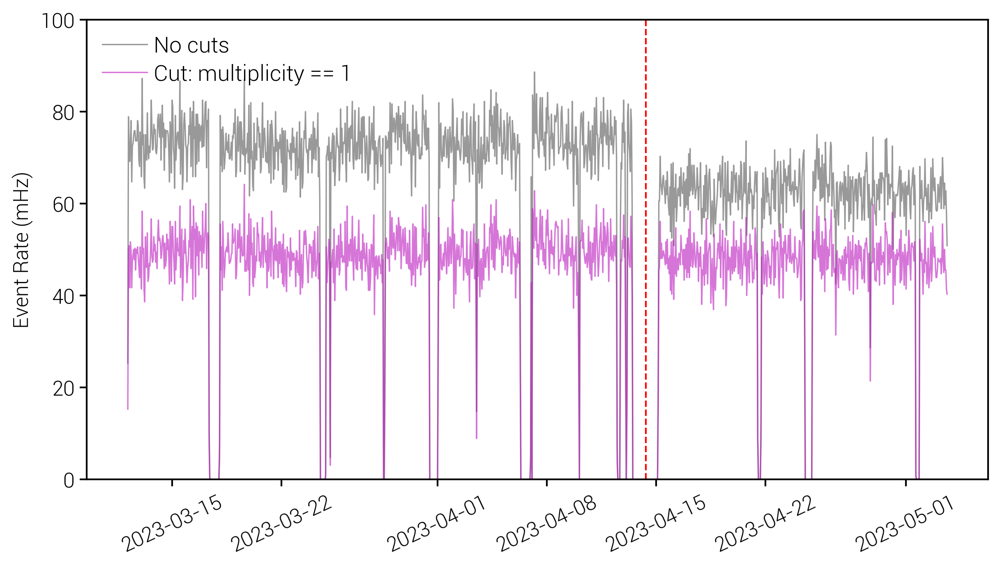

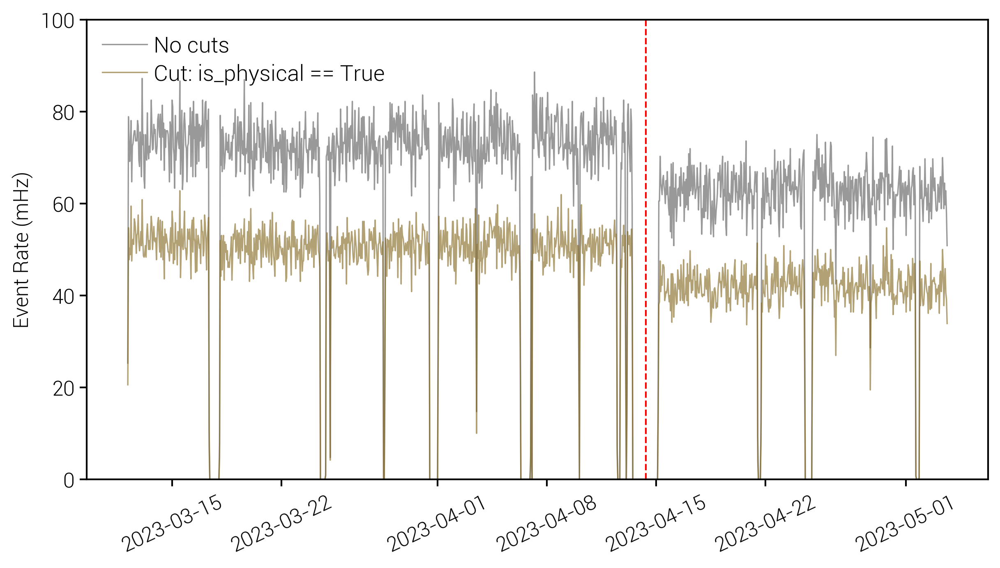

--------------------------PPC----------------------------


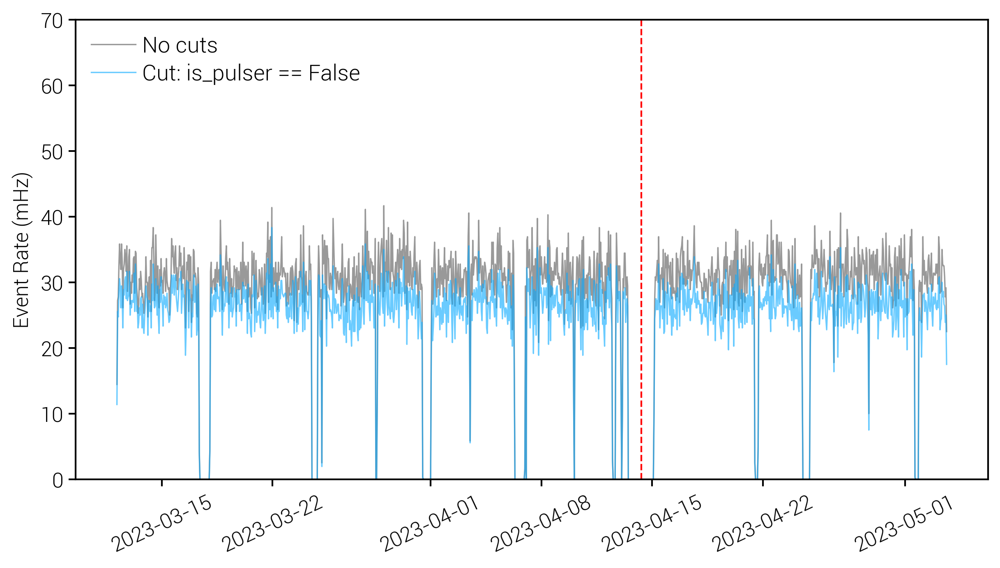

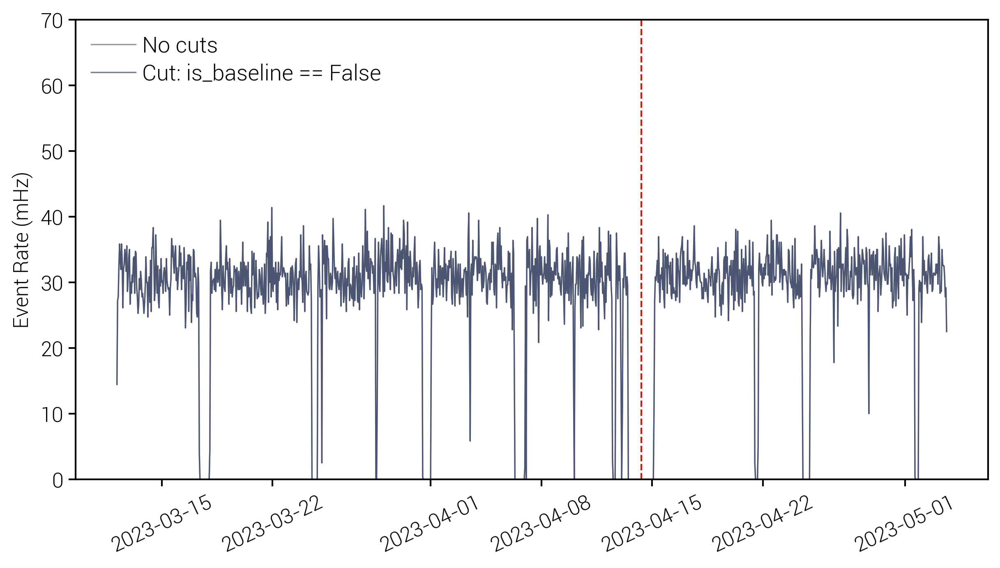

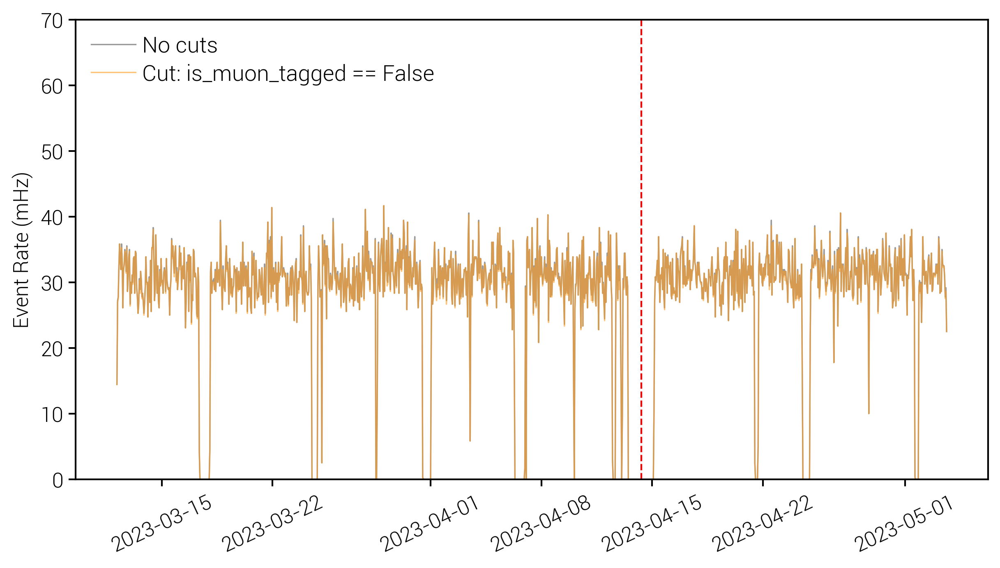

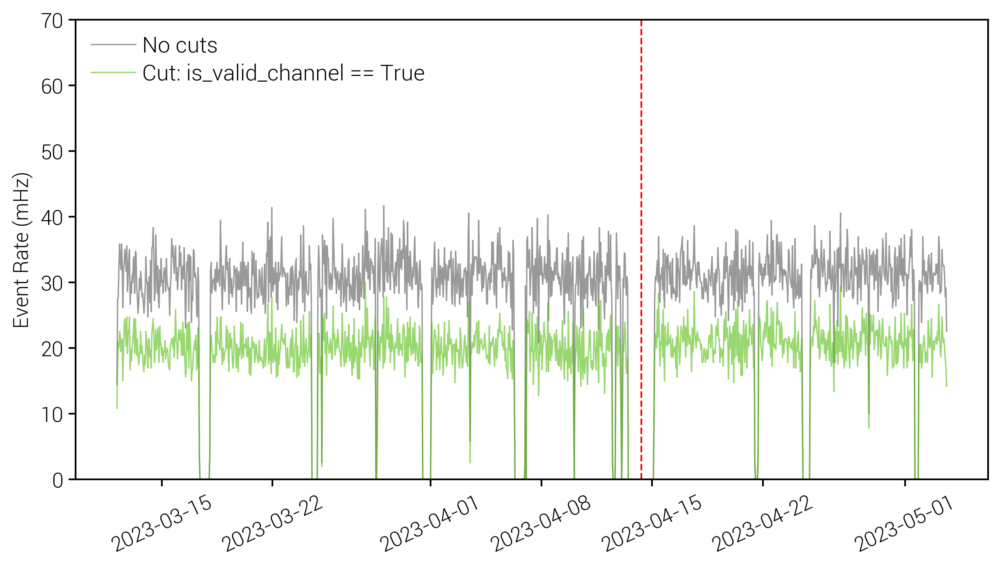

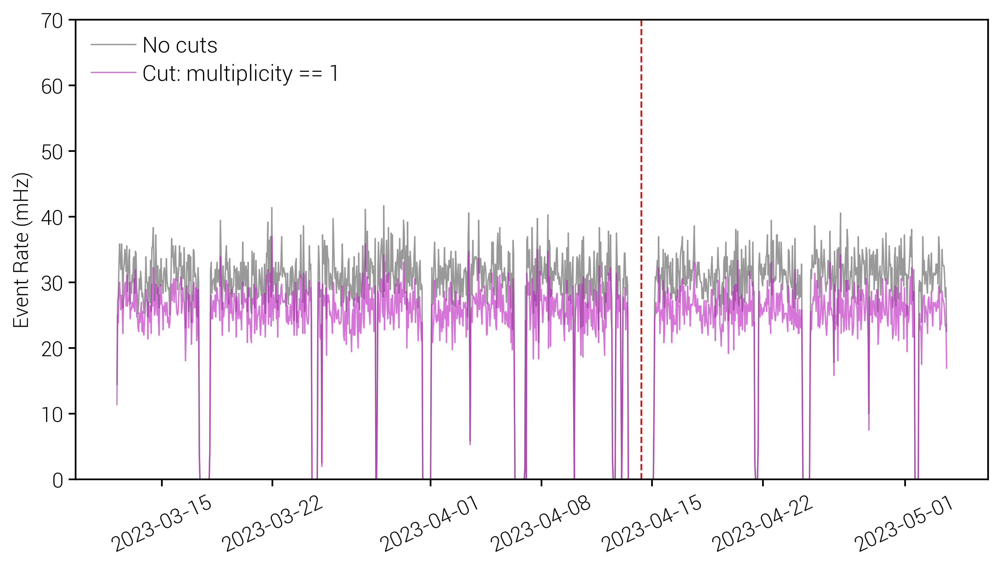

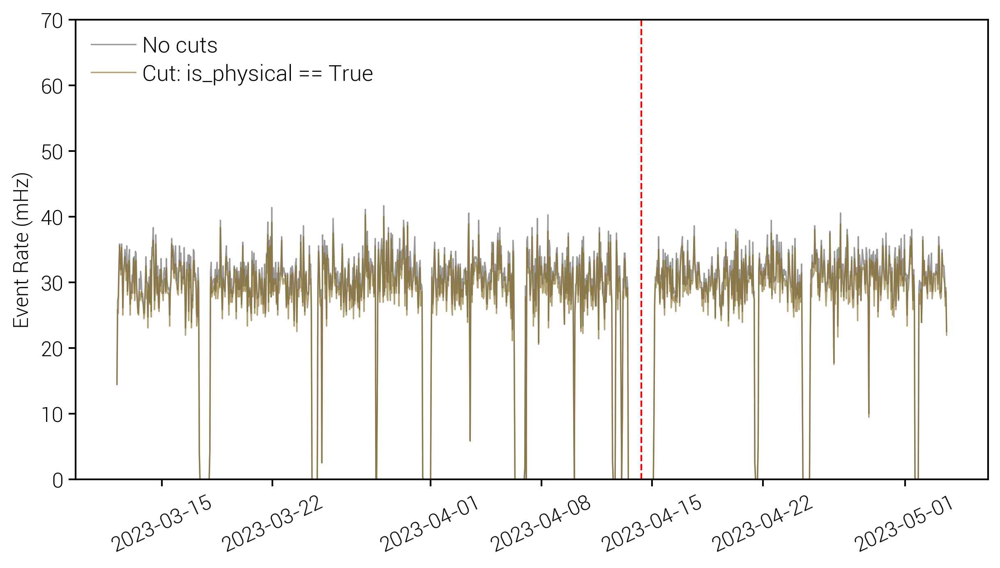

In [26]:
yranges = [(0, 350), (0, 100), (0, 100), (0, 70)]
for i, (d_type, yr) in enumerate(zip(nice_det_name_dict.keys(), yranges)):
    det_lab         = nice_det_name_dict[d_type]
    print(f'--------------------------{det_lab}----------------------------')
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)    
    for (cut, val), col in zip(all_cuts, legend_colors[1:]):
        fig, ax = lps.subplots()
        ax.plot(data_det_series.index, data_det_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
        ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
        df_test        = data_det[data_det[cut]==val]
        df_test_series = resample_df(df_test)

        ax.plot(df_test_series.index, df_test_series, linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
        ax.set_title(f'')
        ax.set_ylabel('Event Rate (mHz)')
        ax.legend(ncol=1, fontsize=13, loc='upper left')
        ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
        ax.set_ylim(yr)
        plt.show()


### Energy

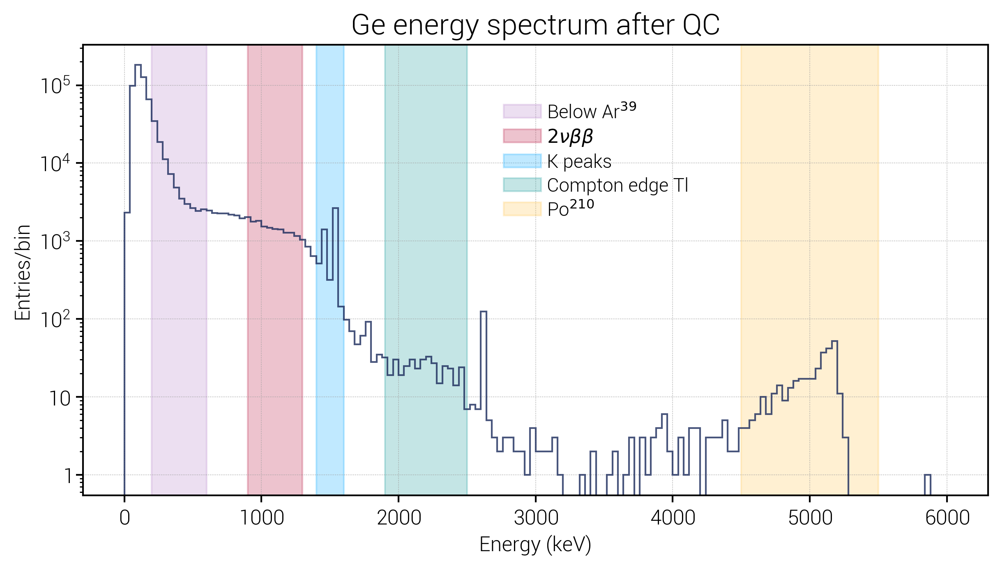

In [27]:
fig, ax = lps.subplots()
data_filt.energy.hist(bins=150, range=(0, 6000), log=True, alpha=0.8, histtype='step', color=lps.colors['legend_darkblue'])
plt.axvspan( 200, 600, label=r'Below Ar$^{39}$',  color=lps.colors['violet'],      alpha=0.25)
plt.axvspan( 900,1300, label=r'$2\nu\beta\beta$', color=lps.colors['red'],         alpha=0.25)
plt.axvspan(1400,1600, label='K peaks'          , color=lps.colors['legend_blue'], alpha=0.25)
plt.axvspan(1900,2500, label='Compton edge Tl'  , color=lps.colors['teal'],        alpha=0.25)
plt.axvspan(4500,5500, label=r'Po$^{210}$'      , color=lps.colors['yellow'],      alpha=0.25)
plt.title('Ge energy spectrum after QC', fontsize=17)
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(bbox_to_anchor=(0.45, 0.9))
#plt.xlim(0, 2000)
plt.show()

In [28]:
def evt_arte_energy_cuts(df, e1, e2):
    df_e = df[(df.energy>e1)&(df.energy<=e2)]
    df_e_series = resample_df(df_e)
    return df_e_series

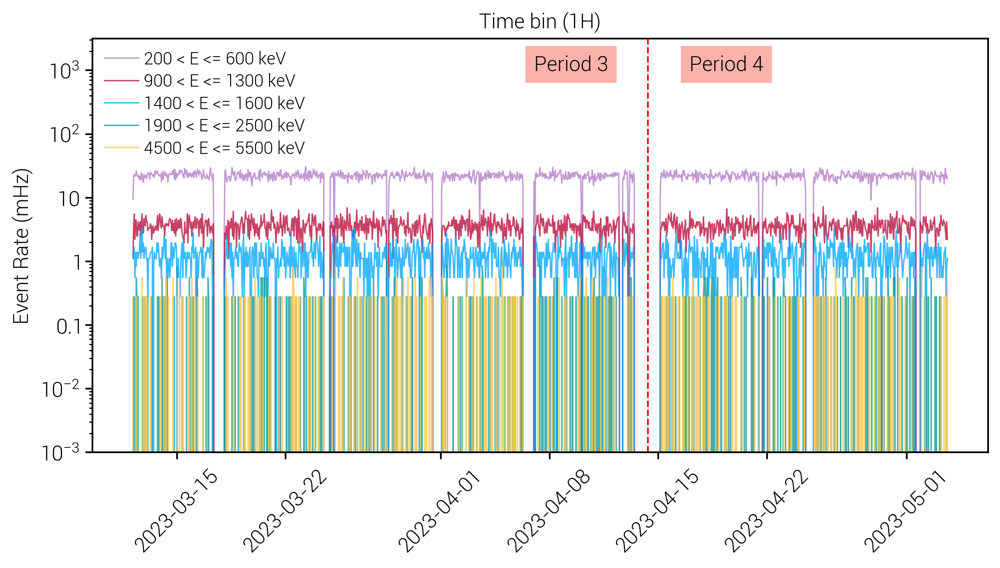

In [29]:
fig, ax = lps.subplots()
plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 1000, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 1000, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for (e1, e2), col in zip([( 200, 600),
                          ( 900,1300),
                          (1400,1600),
                          (1900,2500),
                          (4500,5500)], ['violet', 'red', 'legend_blue', 'teal', 'yellow']):
    data_filt_e    = data_filt[(data_filt.energy>e1)&(data_filt.energy<=e2)]
    data_filt_e_sr = resample_df(data_filt_e)
    plt.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(fontsize=10, loc='upper left')
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-3), 10**3.5)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

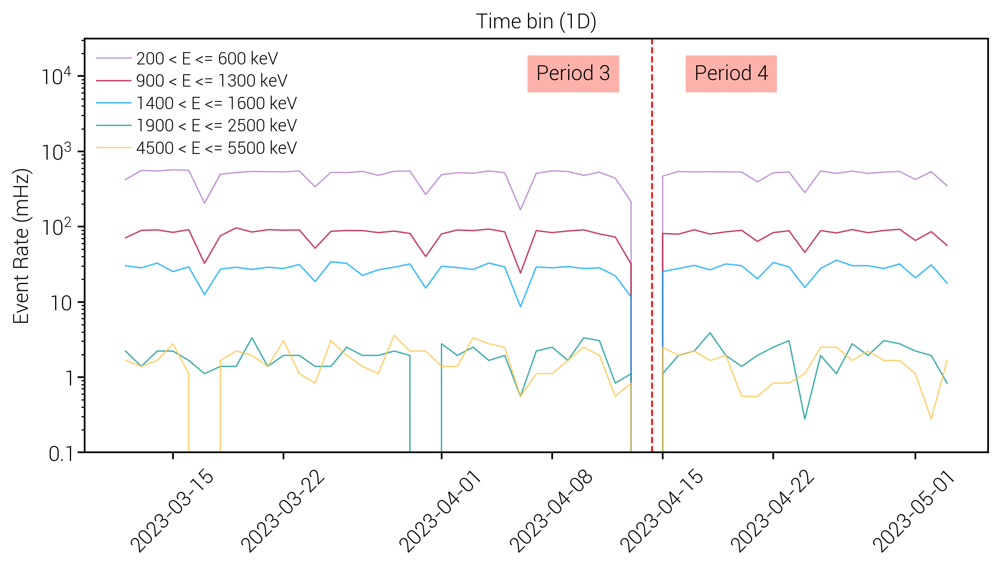

In [30]:
fig, ax = lps.subplots()
plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 9000, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 9000, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for (e1, e2), col in zip([( 200, 600),
                          ( 900,1300),
                          (1400,1600),
                          (1900,2500),
                          (4500,5500)], ['violet', 'red', 'legend_blue', 'teal', 'yellow']):
    data_filt_e    = data_filt[(data_filt.energy>e1)&(data_filt.energy<=e2)]
    data_filt_e_sr = resample_df_days(data_filt_e)
    plt.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
plt.title('Time bin (1D)')
plt.ylabel('Event Rate (mHz)')
plt.legend(fontsize=10, loc='upper left')
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-1), 10**4.5)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

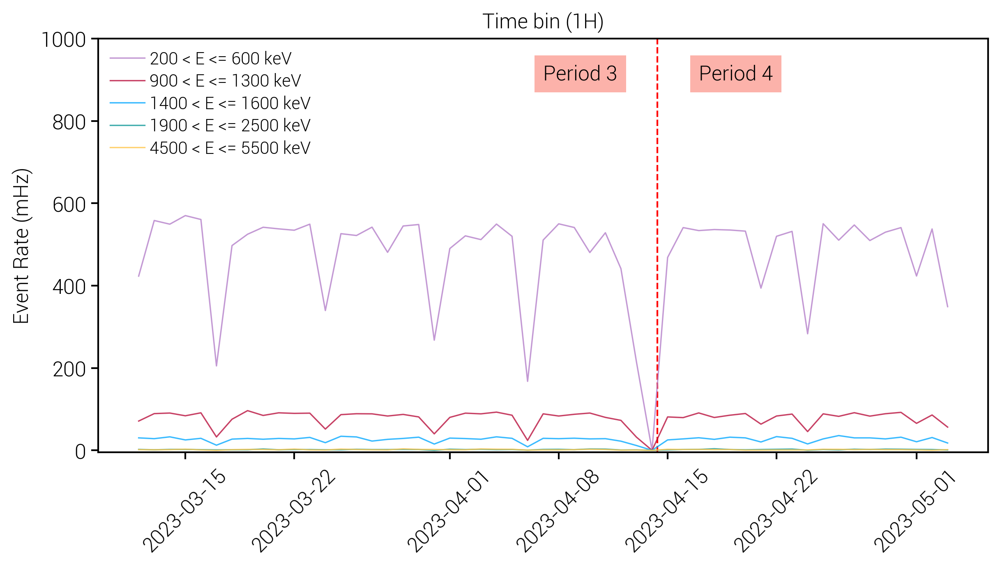

In [31]:
fig, ax = lps.subplots()
plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 900, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 900, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for (e1, e2), col in zip([( 200, 600),
                          ( 900,1300),
                          (1400,1600),
                          (1900,2500),
                          (4500,5500)], ['violet', 'red', 'legend_blue', 'teal', 'yellow']):
    data_filt_e    = data_filt[(data_filt.energy>e1)&(data_filt.energy<=e2)]
    data_filt_e_sr = resample_df_days(data_filt_e)
    plt.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(fontsize=10, loc='upper left')
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-5, 1000)
plt.show()

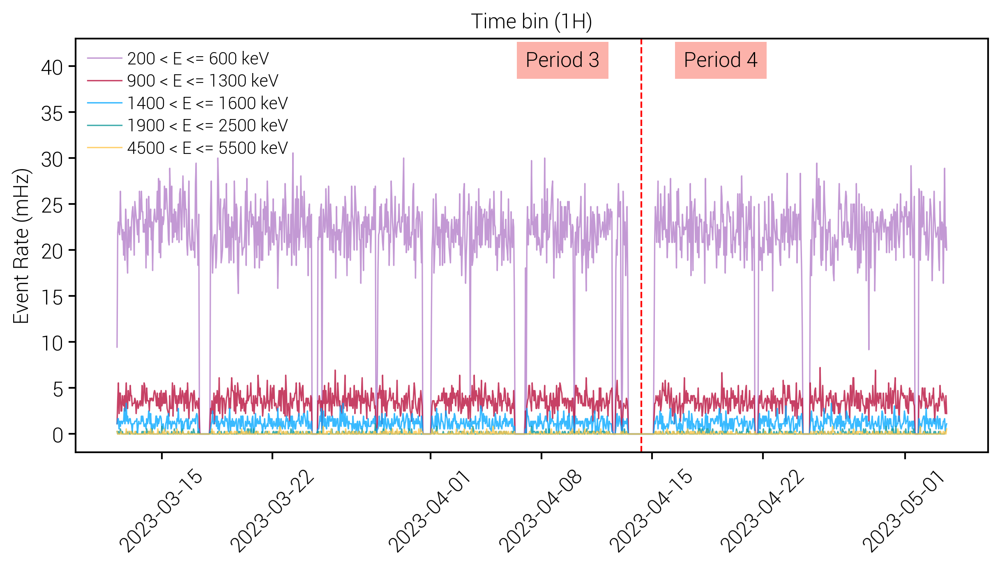

In [32]:
fig, ax = lps.subplots()
plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 40, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 40, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for (e1, e2), col in zip([( 200, 600),
                          ( 900,1300),
                          (1400,1600),
                          (1900,2500),
                          (4500,5500)], ['violet', 'red', 'legend_blue', 'teal', 'yellow']):
    data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2)
    plt.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(fontsize=10, loc='upper left')
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-2, 43)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.show()

### Separate energy regions and detector types:

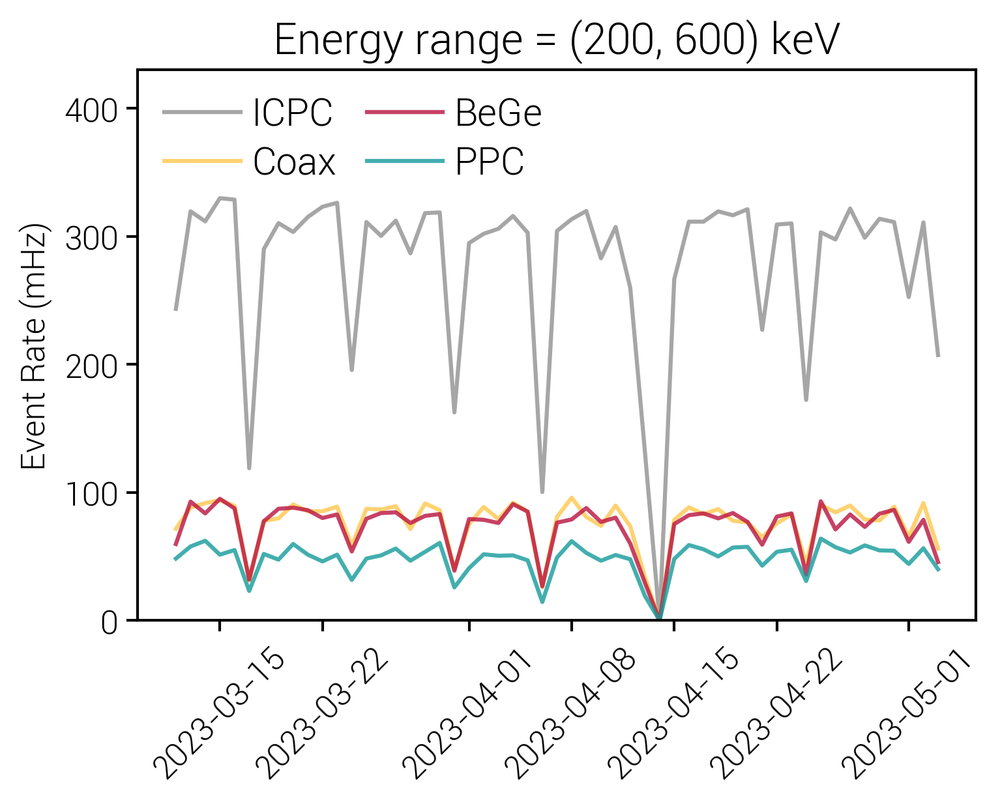

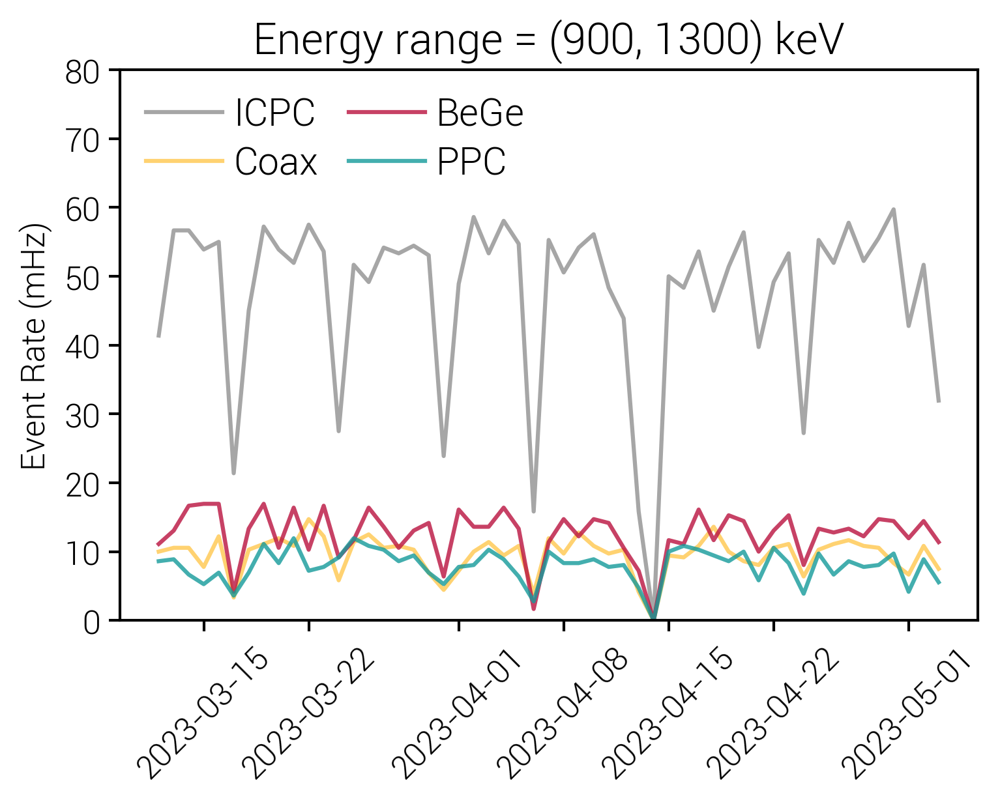

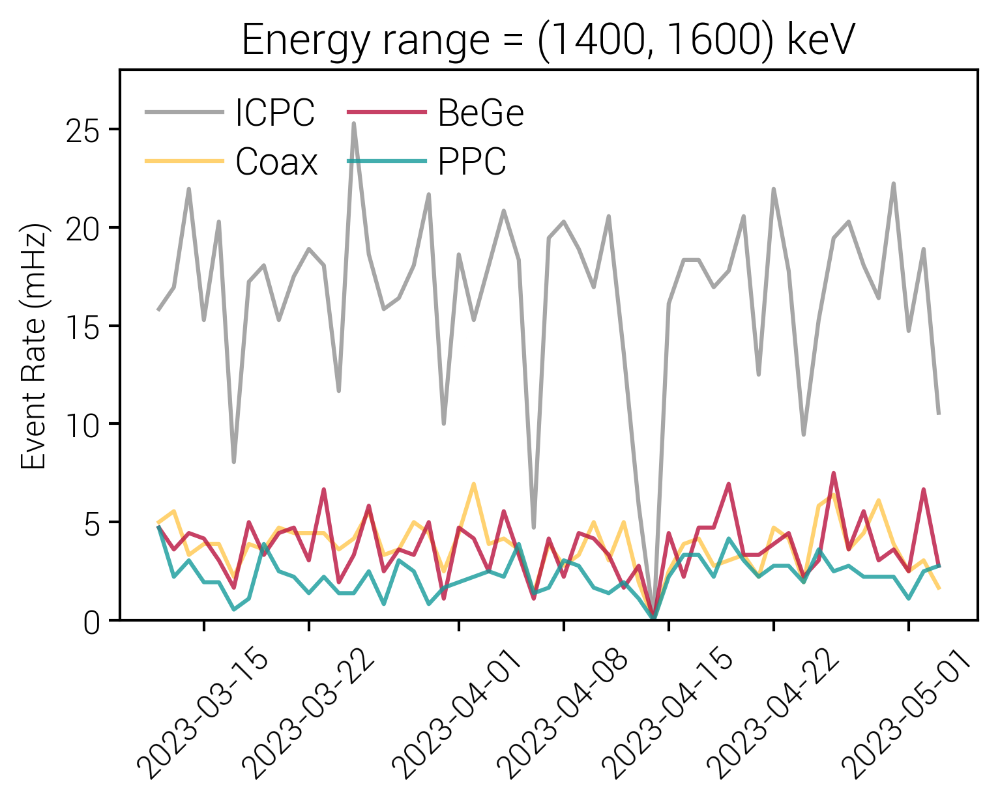

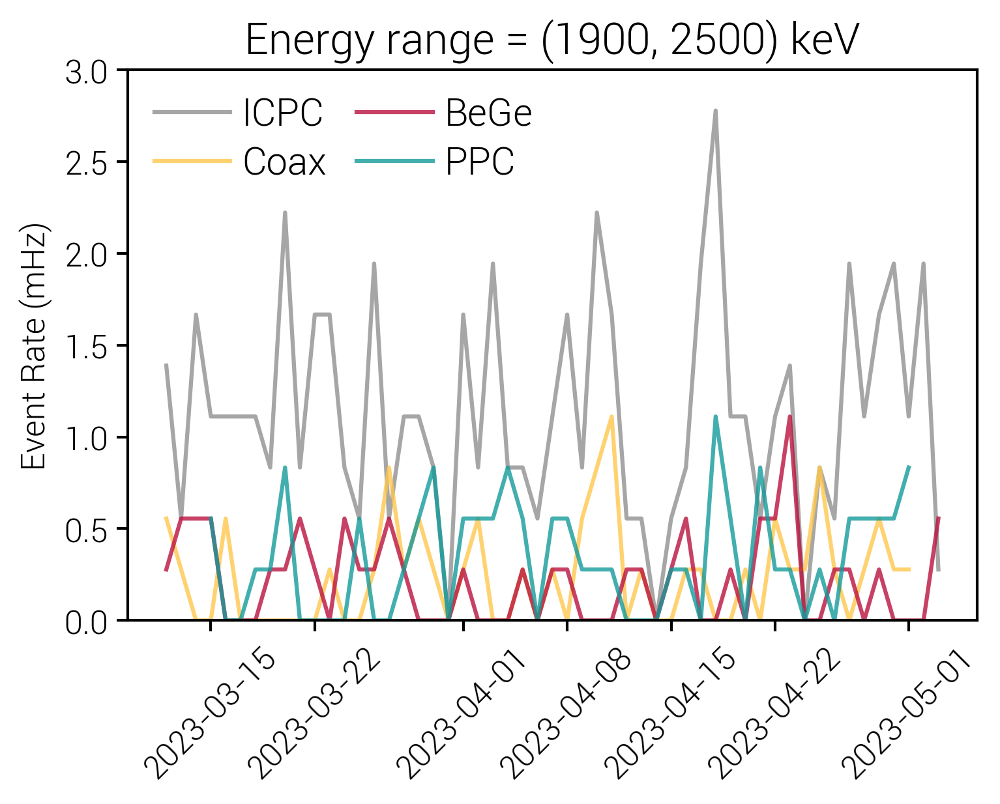

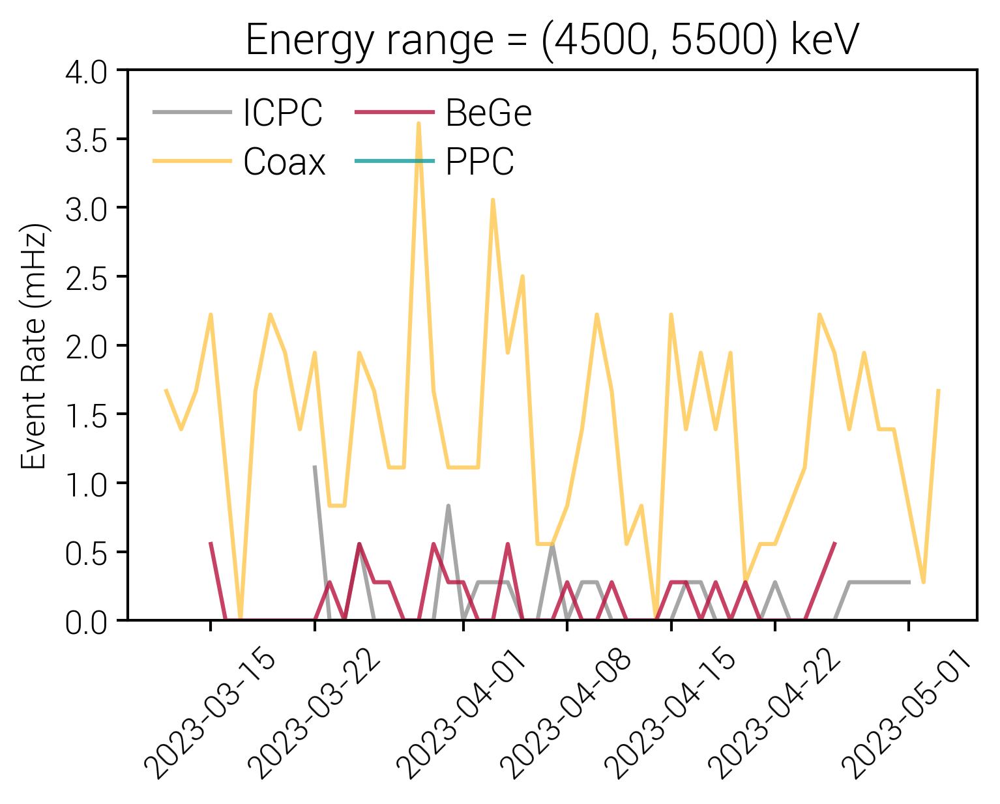

In [33]:
for (e1, e2), yl in zip([( 200, 600),
                     ( 900,1300),
                     (1400,1600),
                     (1900,2500),
                     (4500,5500)], [(0, 430), (0, 80), (0, 28), (0, 3), (0, 4)]):
    fig, ax = lps.subplots(figsize=(5, 4))
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
        det_lab         = nice_det_name_dict[d_type]
        data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
        data_filt_det_e_s = resample_df_days(data_filt_det_e)
        plt.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        plt.title(f'Energy range = ({e1}, {e2}) keV', fontsize=16)
        plt.ylabel('Event Rate (mHz)')
        plt.legend(fontsize=14, loc='upper left', ncol=2)
        plt.xticks(rotation=45)# Rotate x-axis labels for better readability
        plt.ylim(yl)
        #plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
    plt.show()

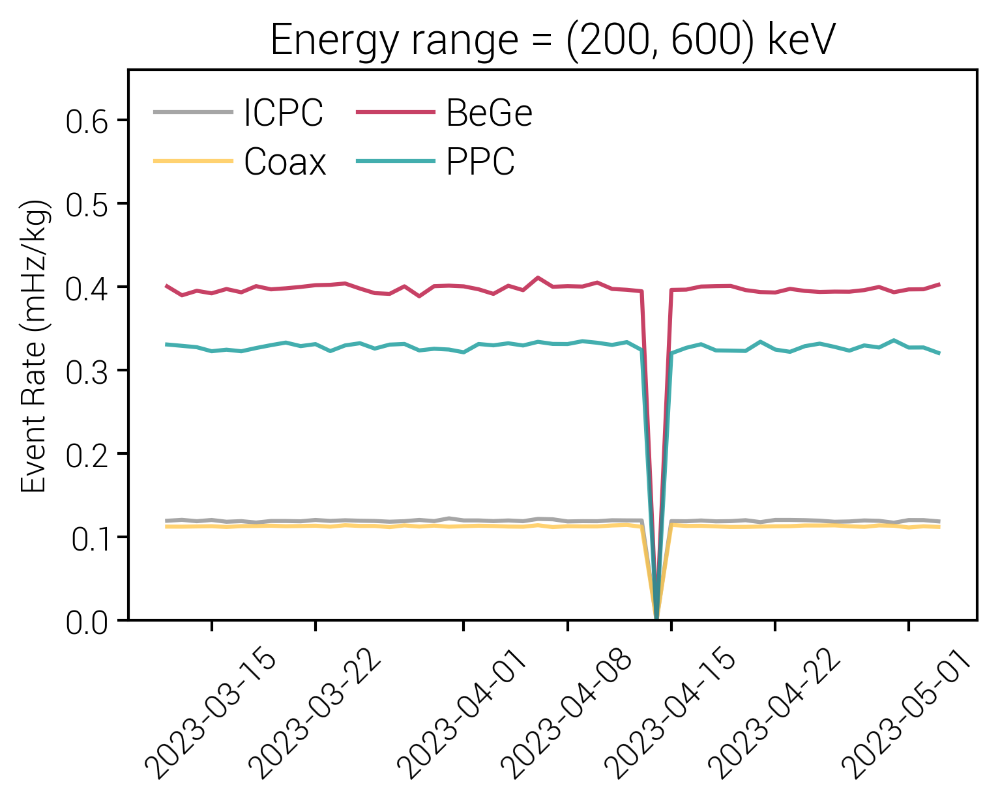

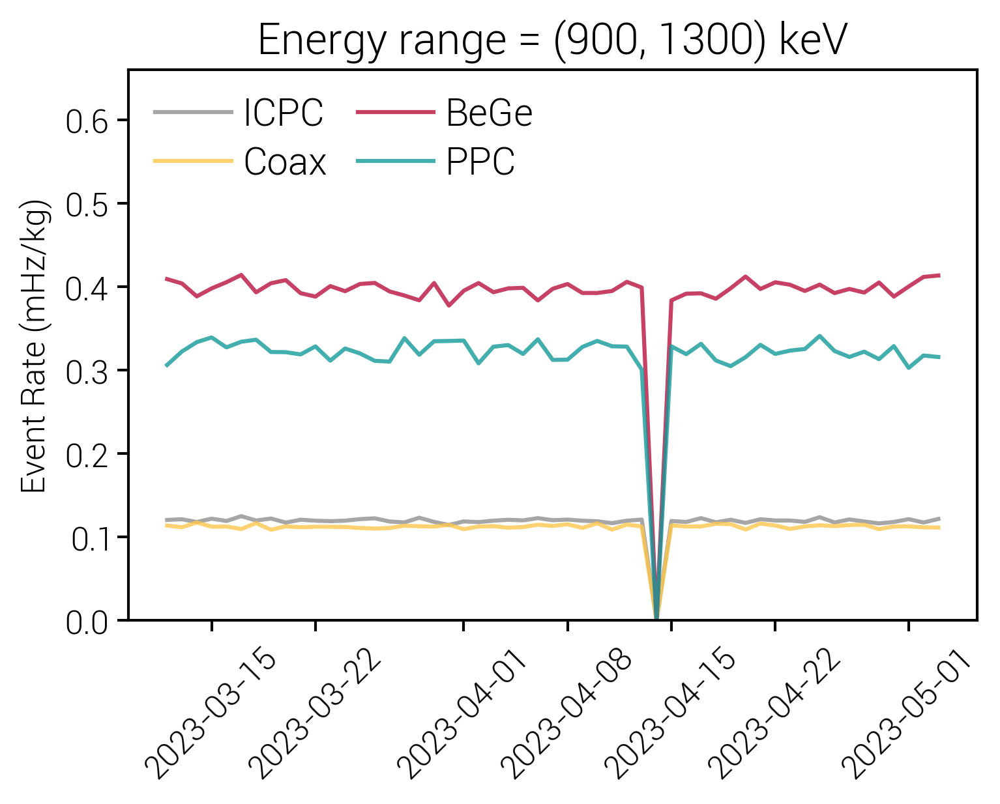

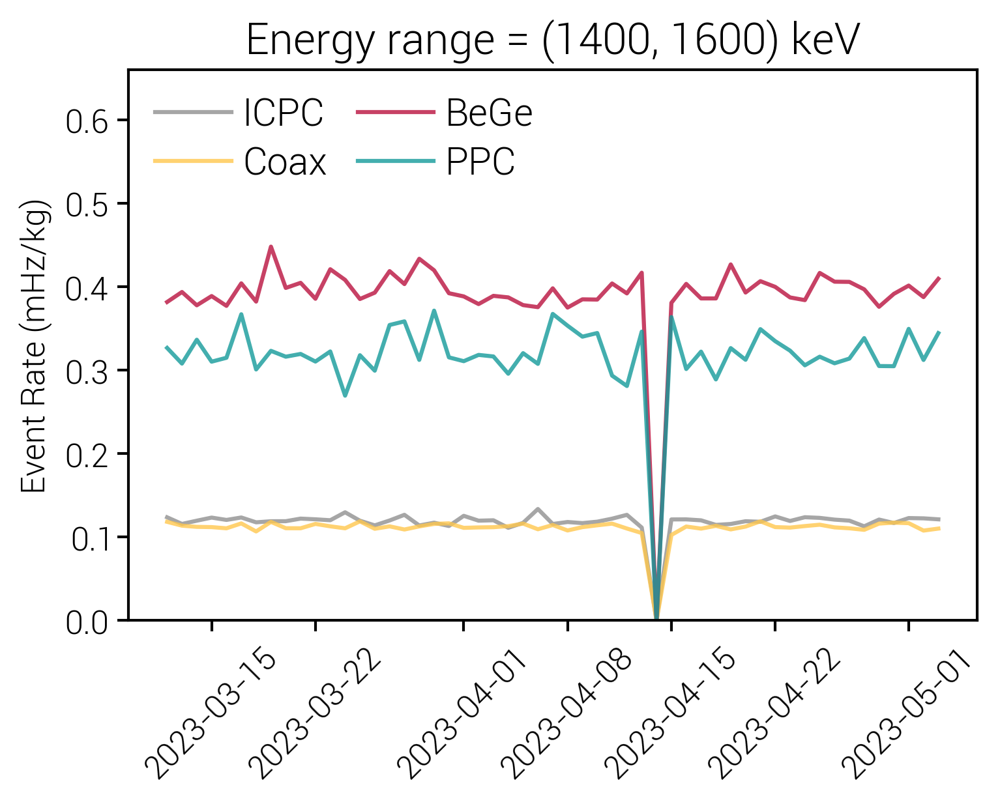

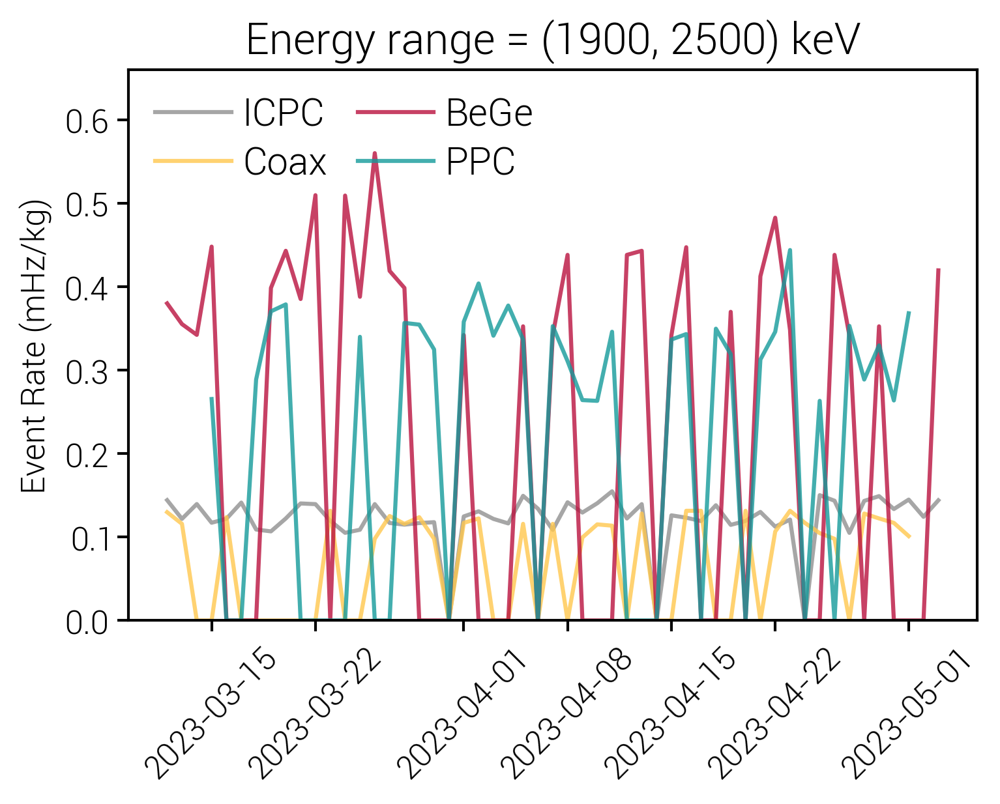

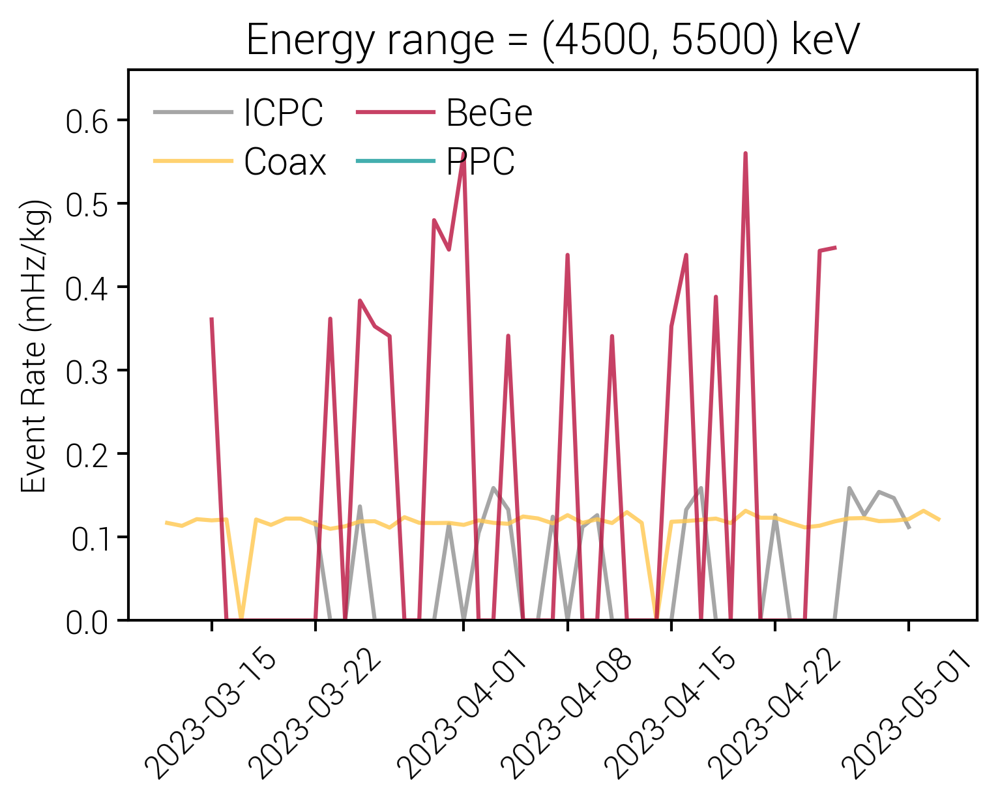

In [34]:
for (e1, e2), yl in zip([( 200, 600),
                         ( 900,1300),
                         (1400,1600),
                         (1900,2500),
                         (4500,5500)], [(0, 0.66), (0, 0.66), (0, 0.66), (0, 0.66), (0, 0.66)]):
    fig, ax = lps.subplots(figsize=(5, 4))
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
        det_lab         = nice_det_name_dict[d_type]
        data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
        data_filt_det_e_s = resample_df_norm_mass_days(data_filt_det_e)
        plt.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        plt.title(f'Energy range = ({e1}, {e2}) keV', fontsize=16)
        plt.ylabel('Event Rate (mHz/kg)')
        plt.legend(fontsize=14, loc='upper left', ncol=2)
        plt.xticks(rotation=45)# Rotate x-axis labels for better readability
        plt.ylim(yl)
        #plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
    plt.show()

### Silver and golden datasets:

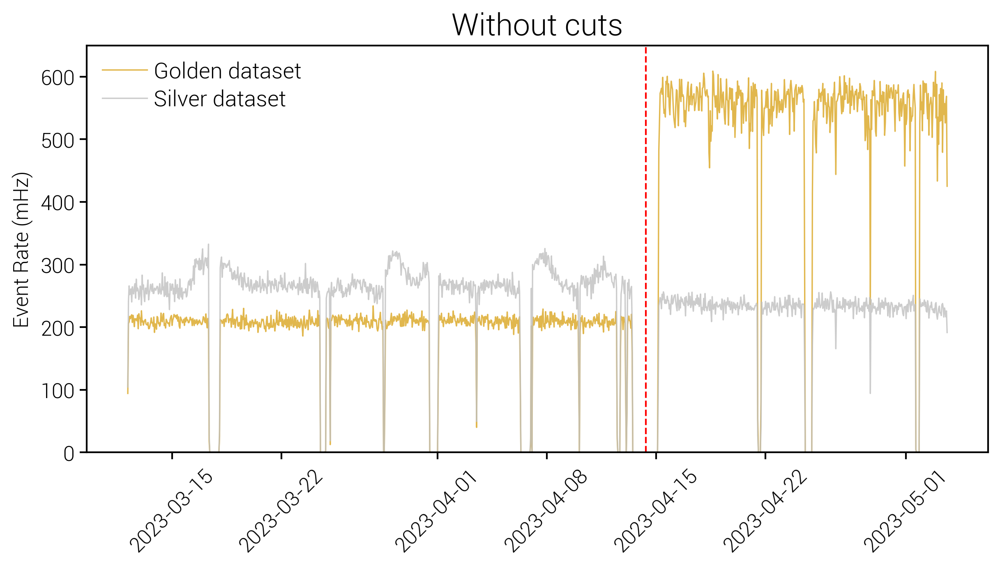

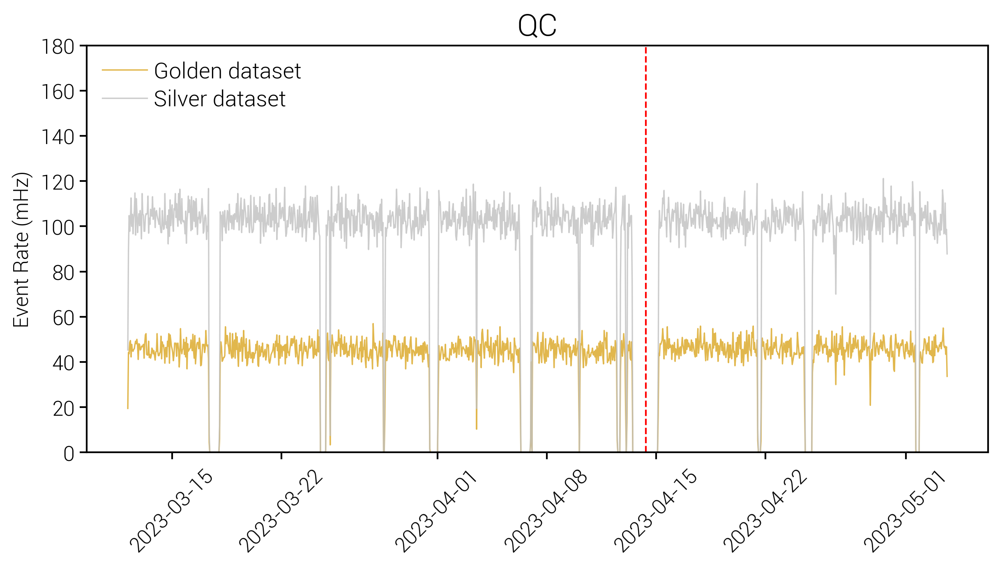

In [36]:
for titl, data_sampl, yl in zip(['Without cuts', 'QC'], [data, data_filt], [(0, 650), (0, 180)]):
    data_golden = data_sampl[data_sampl.is_usable_aoe == True ]
    data_silver = data_sampl[data_sampl.is_usable_aoe == False]
    data_golden_series = resample_df(data_golden)
    data_silver_series = resample_df(data_silver)
    fig, ax = lps.subplots()
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color='goldenrod', alpha=0.8, label=f'Golden dataset')
    ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color='silver',    alpha=0.8, label=f'Silver dataset')
    ax.set_title(f'{titl}', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)')
    ax.legend(ncol=1, fontsize=13, loc='upper left')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    ax.set_ylim(yl)
    plt.show()

### Separate data before and after veto cut

In [ ]:
data_lar_rej        = data[data.is_lar_rejected==False]
data_lar_rej_series = resample_df(data_lar_rej)

data_filt_lar_rej        = data_filt[data_filt.is_lar_rejected==False]
data_filt_lar_rej_series = resample_df(data_filt_lar_rej)

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
#plt.text(pd.to_datetime('2023-04-05'), 200, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
#plt.text(pd.to_datetime('2023-04-17'), 200, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

#plt.plot(data_series     .index, data_series,      linewidth=0.8, color='grey', alpha=0.8, label='All evts')
#plt.plot(data_lar_rej_series     .index, data_lar_rej_series,      linewidth=0.8, color='skyblue', alpha=0.8, label='LAr rej')
plt.plot(data_filt_series.index, data_filt_series, linewidth=0.8, color='teal', alpha=0.7, label='QC')
plt.plot(data_filt_lar_rej_series.index, data_filt_lar_rej_series, linewidth=0.8, color='indianred',   alpha=0.8, label='QC + LAr rej')
#plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(fontsize=13, loc='upper left')
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 220)
plt.show()